### Notebool to test multiple clustering schemes with multiple models

#### Clustering schemes
1. Agglomerative clustering
2. K means
3. DBSCAN *dbscan needs k-distance plot
4. Spectral clustering

#### Moldes
1. m2-model
2. m2-normed model
3. m4 model

In [1]:
%reload_ext autoreload
%autoreload 2
import os
import sys
import glob
import random
import numpy as np
import scipy as sc
import pandas as pd
import tensorflow as tf
from pyhdf.SD import SD, SDC 
from scipy import stats

# visualization
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import patches as mpl_patches

# clusterings
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN

# TSNE
from sklearn.manifold import TSNE as TSNEs

In [2]:
import copy

In [3]:
from sklearn.cluster import SpectralClustering

#### Processing function

In [4]:
def load_model(model_dir, epoch, mtype):
    print(" Load {} at {} epoch".format(mtype, epoch))
    model_def = model_dir+'/'+mtype+'.json'
    model_weight = model_dir+'/'+mtype+'-'+str(epoch)+'.h5'
    with open(model_def, "r") as f:
        model = tf.keras.models.model_from_json(f.read())
    model.load_weights(model_weight)
    return model

In [5]:
def reconst_img(_patches, _patches_labels, _xy_list):
    ix, iy = _patches.shape[:2]
    img_array = np.zeros((ix,iy)).astype(np.float64)
    img_array[:,:] = np.nan
    for idx, (x,y) in enumerate(_xy_list):
        img_array[x,y] = _patches_labels[idx]
    return img_array

In [6]:
def compute_agl(encoder, patches_list,n_cluster = 12):
    encs_list = []
    for i in patches_list:
        encs = encoder.predict(i.reshape(1,128,128,6))
        encs_list += [encs.mean(axis=(1,2))]
    features = np.concatenate(encs_list, axis=0)
    method = AgglomerativeClustering(n_clusters=n_cluster)
    _patches_labels = method.fit(features)
    return _patches_labels.labels_, features

In [7]:
def compute_kmeans(encoder, patches_list,n_cluster = 10):
    """ initialization = kmeans ++
    """
    encs_list = []
    for i in patches_list:
        encs = encoder.predict(i.reshape(1,128,128,6))
        encs_list += [encs.mean(axis=(1,2))]
    features = np.concatenate(encs_list, axis=0)
    method = KMeans(n_clusters=n_cluster,init='k-means++')
    _patches_labels = method.fit_predict(features)
    return _patches_labels, features

In [8]:
def compute_dbscan(encoder, patches_list,eps=0.5):
    """ initialization = kmeans ++
    """
    encs_list = []
    for i in patches_list:
        encs = encoder.predict(i.reshape(1,128,128,6))
        encs_list += [encs.mean(axis=(1,2))]
    features = np.concatenate(encs_list, axis=0)
    method = DBSCAN(eps=eps,metric='euclidean')
    _patches_labels = method.fit_predict(features)
    return _patches_labels, features

In [9]:
def compute_spectral(encoder, patches_list,n_cluster = 12):
    """ initialization = kmeans ++
    """
    encs_list = []
    for i in patches_list:
        encs = encoder.predict(i.reshape(1,128,128,6))
        encs_list += [encs.mean(axis=(1,2))]
    features = np.concatenate(encs_list, axis=0)
    method = SpectralClustering(
        n_clusters=n_cluster,random_state=0,affinity='rbf',assign_labels='discretize')
    _patches_labels = method.fit_predict(features)
    return _patches_labels, features

In [10]:
def compute_tsne(data, ndim=2, nperplex=15):
    tsne = TSNEs(n_components=ndim, perplexity=nperplex,random_state=0)
    features = tsne.fit_transform(data)
    return features 

In [11]:
def compute_patch_stats(img_array, statistics, n_cluster=12):
    '''
    Find stats for patches within each cluster
    Args: 
        Img_array (2D array): input array of patches' cluster numbers 
        Statistics: statistics of patches calculated above 
        N_cluster: number of clusters 
    Returns: array containing statistics of each cluster's patches
    '''
    physics = []
    for icluster in range(n_cluster):
        #get index
        cluster_idx = np.where(img_array == icluster)
        physics += [statistics[cluster_idx]]
    return physics

--------------------
### Load MODIS 02, 35  

- MOD02

In [12]:
libdir = '/home/tkurihana/scratch-midway2/clouds/src_analysis/lib_hdfs'
sys.path.insert(1,os.path.join(sys.path[0],libdir))
from alignment_lib import  decode_cloud_flag, const_clouds_array
from analysis_lib import _get_colors, _gen_patches
from lib_modis02 import proc_sds

In [13]:
d = '/home/tkurihana/scratch-midway2/clouds/analysis_mod021KM/data/MOD02'
bname='MOD021KM.A2015335.mosaic.061.2019271223018.psmcgscs_000501379735'
#bname='MOD021KM.A2015335.mosaic.061.2019271222156.psmcgscs_000501379734'
hdf_filelist=[
    d+'/'+str(bname)+'.EV_500_Aggr1km_RefSB_4.hdf',
    d+'/'+str(bname)+'.EV_500_Aggr1km_RefSB_5.hdf',
    d+'/'+str(bname)+'.EV_1KM_Emissive_1.hdf',
    d+'/'+str(bname)+'.EV_1KM_Emissive_8.hdf',
    d+'/'+str(bname)+'.EV_1KM_Emissive_9.hdf',
    d+'/'+str(bname)+'.EV_1KM_Emissive_11.hdf',
]

b6_hdf = (SD(hdf_filelist[0], SDC.READ)).select("EV_500_Aggr1km_RefSB")
b7_hdf = (SD(hdf_filelist[1], SDC.READ)).select("EV_500_Aggr1km_RefSB")
b20_hdf = (SD(hdf_filelist[2], SDC.READ)).select("EV_1KM_Emissive")
b28_hdf = (SD(hdf_filelist[3], SDC.READ)).select("EV_1KM_Emissive")
b29_hdf = (SD(hdf_filelist[4], SDC.READ)).select("EV_1KM_Emissive")
b31_hdf = (SD(hdf_filelist[5], SDC.READ)).select("EV_1KM_Emissive")

In [14]:
#Decoding 
b6_array, b6 = proc_sds(b6_hdf)
b7_array, b7 = proc_sds(b7_hdf)
b20_array, b20 = proc_sds(b20_hdf)
b28_array, b28 = proc_sds(b28_hdf)
b29_array, b29 = proc_sds(b29_hdf)
b31_array, b31 = proc_sds(b31_hdf)

Process bands 6


/home/tkurihana/scratch-midway2/clouds/src_analysis/lib_hdfs/lib_modis02.py:92: RuntimeWarning: invalid value encountered in greater
  invalid_idx = np.where( array > 32767 )


Process bands 7
Process bands 20
Process bands 28
Process bands 29
Process bands 31


#### no- normed mod02 image

In [23]:
nx, ny = b6_array.shape

d_list = []
d_list = [
    b6_array.reshape(nx,ny,1),
    b7_array.reshape(nx,ny,1),
    b20_array.reshape(nx,ny,1),
    b28_array.reshape(nx,ny,1),
    b29_array.reshape(nx,ny,1),
    b31_array.reshape(nx,ny,1),
]

mod02_img = np.concatenate(d_list, axis=2)
mod02_img.shape

(3562, 3540, 6)

#### normed mod02 image

In [119]:
mod02_means = np.nanmean(mod02_img, axis=(0,1))
mod02_means

array([9.36297945, 2.3077051 , 0.34726163, 2.53648924, 5.92508734,
       6.66203091])

In [120]:
mod02_stdvs = np.nanstd(mod02_img, axis=(0,1))
mod02_stdvs

array([8.268758  , 1.99911265, 0.13512478, 0.73501053, 1.77034368,
       1.73918398])

In [121]:
normed_mod02_img = (mod02_img - mod02_means)/mod02_stdvs

-------------------
- MOD35

In [115]:
#MOD35
d = '/home/tkurihana/clouds/analysis_mod021KM/data/MOD35'
mod35_filelist = glob.glob(d+"/*.hdf")
mod35_filelist.sort()

hdf_cm1 = SD(mod35_filelist[0], SDC.READ)
cm1_sds = hdf_cm1.select('Cloud_Mask')

#Extract cloud flag info
cloud_mask = decode_cloud_flag(cm1_sds)

In [16]:
cloud_array = np.ones(cloud_mask.shape).astype(np.float64)
for ix in range(cloud_mask.shape[0]):
    for iy in range(cloud_mask.shape[1]):
        if cloud_mask[ix,iy] == 0:
            cloud_array[ix,iy] = 0
        else:
            cloud_array[ix,iy] = np.nan    

#### Clearsky array 

In [67]:
nocloud_array = np.ones(cloud_mask.shape).astype(np.float64)
for ix in range(cloud_mask.shape[0]):
    for iy in range(cloud_mask.shape[1]):
        if cloud_mask[ix,iy] >= 1 and cloud_mask[ix,iy] <= 3:
            nocloud_array[ix,iy] = 1
        else:
            nocloud_array[ix,iy] = np.nan

In [68]:
_nx, _ny = 27,27
clearsky_array =np.ones((_nx,_ny)).astype(np.float64)
clearsky_array[:,:] = np.nan
width = height = 128
for i in range(_nx):
    for j in range(_ny):
        if np.any(nocloud_array[i*width:(i+1)*width,j*height:(j+1)*height] == 1):
            if np.any(nocloud_array[i*width:(i+1)*width,j*height:(j+1)*height] == 1):
                tmp = nocloud_array[i*width:(i+1)*width,j*height:(j+1)*height]
                nclouds = len(np.argwhere(tmp == 1))
                if nclouds/(width*height) > 0.7: # non-clouds is equal or more than 70% 
                    clearsky_array[i,j] = 1

In [69]:
## set clea sky index 
clear_sky_idx = np.where(clearsky_array == 1)

In [79]:
clear_sky_idx_list = []
for ix, iy in zip(clear_sky_idx[0], clear_sky_idx[1]):
    clear_sky_idx_list.append( (ix,iy) )

#### Alignment MOD02 + MOD35

- No normalized data

In [24]:
patches = _gen_patches(mod02_img, normalization=False)
patches_mask = _gen_patches(mod02_img, normalization=False)
patches.shape

(27, 27, 128, 128, 6)

In [81]:
clouds_patches_list, clouds_xy_list = const_clouds_array(patches, cloud_mask, thres=0.3)

In [82]:
nx, ny = patches.shape[:2]
reconst_array = np.zeros((nx*128, ny*128, 6)).astype(float)
clouds_patches_list = np.squeeze(np.asarray(clouds_patches_list))
reconst_array[:,:,:]=np.nan
idx = 0
for i in range(nx):
    for j in range(ny):
        if (i,j) in clouds_xy_list:
            reconst_array[i*128 : (i+1)*128, j*128 : (j+1)*128] = clouds_patches_list[idx]
            idx += 1

For AGU

In [84]:
# prerequisit -- already construct reconst-array at first
maxs = np.nanmax(reconst_array, axis=(0,1))
maxs

array([39.49131722, 10.10764236,  1.65467702,  4.21763439,  8.44013981,
        8.87874712])

In [92]:
nx, ny = patches.shape[:2]
reconst_array = np.zeros((nx*128, ny*128, 6)).astype(float)
clouds_patches_list = np.squeeze(np.asarray(clouds_patches_list))
reconst_array[:,:,:]=np.nan
idx = 0
for i in range(nx):
    for j in range(ny):
        if (i,j) in clouds_xy_list:
            reconst_array[i*128 : (i+1)*128, j*128 : (j+1)*128] = clouds_patches_list[idx]
            idx += 1
        elif (i,j) in clear_sky_idx_list:
            dmax = maxs * np.ones((128,128,6)).astype(float) 
            reconst_array[i*128 : (i+1)*128, j*128 : (j+1)*128] = dmax*100

CheckIO

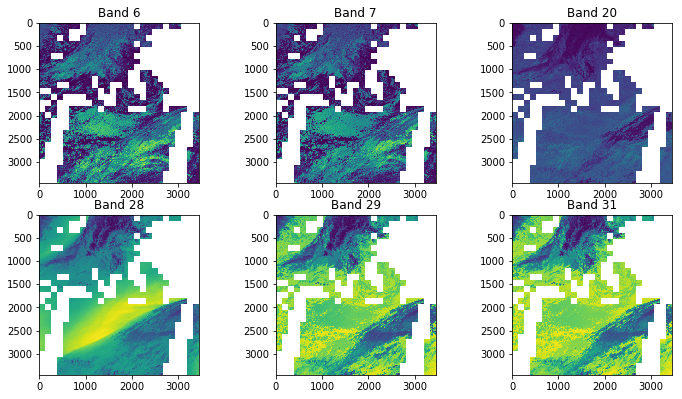

In [24]:
fig = plt.figure(figsize=(12,10))
bands = [6, 7, 20, 28, 29, 31] 
for idx in range(6):
    ax = plt.subplot(3, 3, idx+1)
    if idx<6:
        plt.imshow(reconst_array[:,:,idx])
        plt.title("Band %d" % (bands[idx]))
    else:
        pass#plt.imshow(cloud_mask, cmap='jet')

#### For AGU presentation 
Raw Image

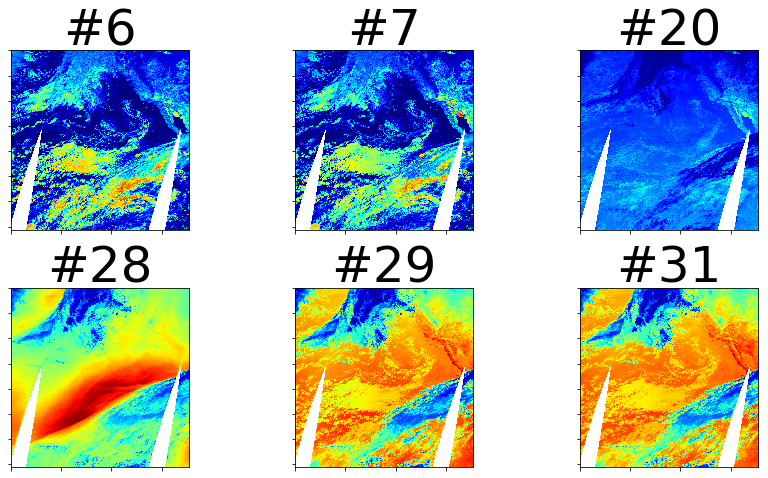

In [130]:
fig = plt.figure(figsize=(12,10))
bands = [6, 7, 20, 28, 29, 31] 
#minor_ticks = np.arange(0,reconst_array.shape[0],128)
for idx in range(6):
    ax = plt.subplot(3, 3, idx+1)
    if idx<6:
        plt.imshow(mod02_img[:,:,idx], cmap='jet')
        plt.title("#%d" % (bands[idx]),fontsize=50)
        #ax.set_xticks(major_ticks)                                                       
        ax.set_yticklabels([])
        ax.set_xticklabels([])
    else:
        pass#plt.imshow(cloud_mask, cmap='jet')
fig.tight_layout()
plt.show()

Add grid lines by every 128 pixel

In [51]:
import matplotlib

In [61]:
reconst_clearsky_array = copy.deepcopy(reconst_array)

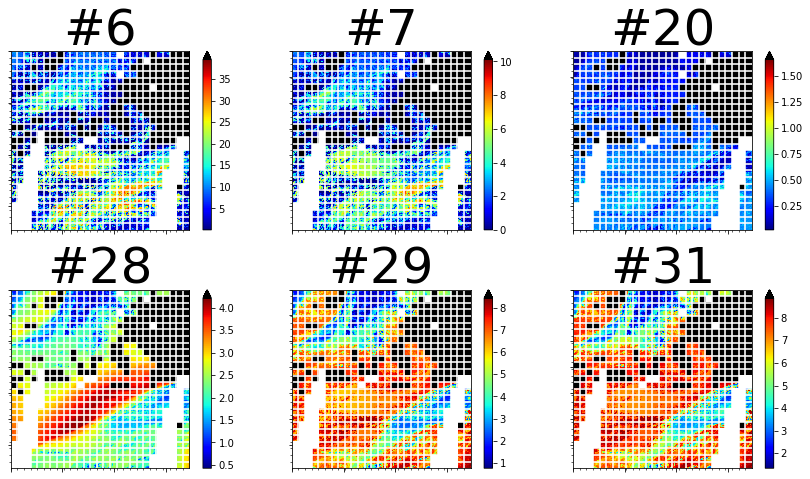

In [129]:
fig = plt.figure(figsize=(12,10))
bands = [6, 7, 20, 28, 29, 31] 
minor_ticks = np.arange(0,reconst_array.shape[0],128)
for idx in range(6):
    ax = plt.subplot(3, 3, idx+1)
    if idx<6:
        im = plt.imshow(reconst_array[:,:,idx], vmax=maxs[idx] , cmap='jet')
        plt.title("#%d" % (bands[idx]),fontsize=50)        
        #ax.set_xticks(major_ticks)                                                       
        ax.set_xticks(minor_ticks, minor=True)                                           
        #ax.set_yticks(major_ticks)                                                       
        ax.set_yticks(minor_ticks, minor=True)   
        ax.grid(which='minor', alpha=0.8,color='white', linestyle='-', linewidth=2) 
        ax.set_yticklabels([])
        ax.set_xticklabels([])
        cbar = fig.colorbar(im, extend='max')
        cbar.cmap.set_over('black')
    else:
        pass#plt.imshow(cloud_mask, cmap='jet')
fig.tight_layout()
plt.show()

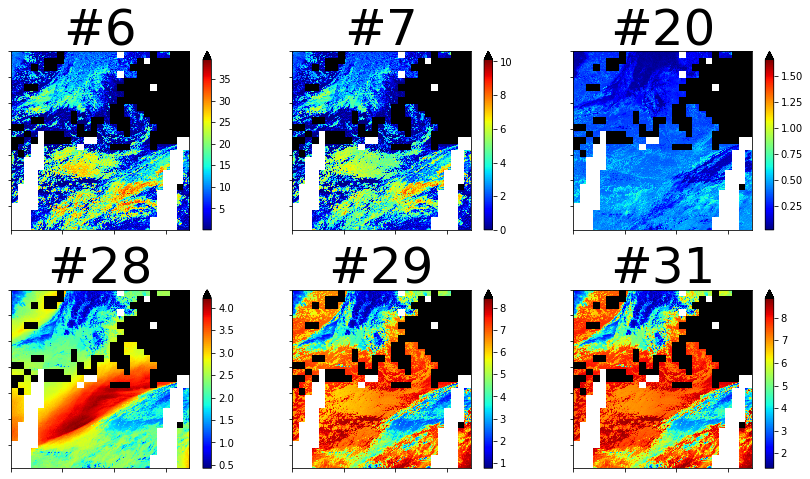

In [96]:
fig = plt.figure(figsize=(12,10))
bands = [6, 7, 20, 28, 29, 31] 
minor_ticks = np.arange(0,reconst_array.shape[0],128)
for idx in range(6):
    ax = plt.subplot(3, 3, idx+1)
    if idx<6:
        #plt.imshow(reconst_array[:,:,idx])
        im = plt.imshow(reconst_array[:,:,idx], vmax=maxs[idx], cmap='jet' )
        #plt.title("Band %d" % (bands[idx]),fontsize=50)
        plt.title("#%d" % (bands[idx]),fontsize=50)
        #ax.set_xticks(major_ticks)                                                       
        #ax.set_xticks(minor_ticks, minor=True)                                           
        #ax.set_yticks(major_ticks)                                                       
        #ax.set_yticks(minor_ticks, minor=True)   
        #ax.grid(which='minor', alpha=0.8,color='white', linestyle='-', linewidth=2) 
        ax.set_yticklabels([])
        ax.set_xticklabels([])
        cbar = fig.colorbar(im, extend='max')
        cbar.cmap.set_over('black')
    else:
        pass#plt.imshow(cloud_mask, cmap='jet')
fig.tight_layout()
#plt.show()

Cloud Mask

/home/tkurihana/.conda/envs/tf-cpu/lib/python3.6/site-packages/numpy/lib/histograms.py:754: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/tkurihana/.conda/envs/tf-cpu/lib/python3.6/site-packages/numpy/lib/histograms.py:755: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


(array([7774628.,       0.,       0.,  454244.,       0.,       0.,
         637182.,       0.,       0., 2963019.]),
 array([0. , 0.3, 0.6, 0.9, 1.2, 1.5, 1.8, 2.1, 2.4, 2.7, 3. ]),
 <a list of 10 Patch objects>)

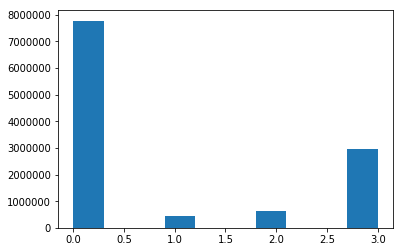

In [120]:
plt.hist(cloud_mask.ravel())

In [121]:
np.nanmax(cloud_mask)

3.0

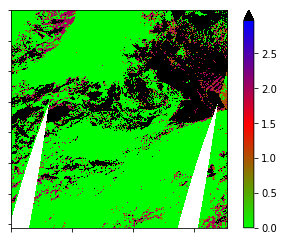

In [132]:
fig = plt.figure()
ax = plt.subplot(1,1,1)
im = ax.imshow(cloud_mask, vmax=np.nanmax(cloud_mask)*0.99, cmap='brg_r')
ax.set_yticklabels([])
ax.set_xticklabels([])
cbar = fig.colorbar(im, extend='max')
cbar.cmap.set_over('black')   
plt.show()
#plt.colorbar()

- Normalizaed data

In [123]:
normed_patches = _gen_patches(normed_mod02_img, normalization=False)
normed_patches_mask = _gen_patches(normed_mod02_img, normalization=False)
normed_patches.shape

(27, 27, 128, 128, 6)

In [124]:
normed_clouds_patches_list, normed_clouds_xy_list = const_clouds_array(
    normed_patches, cloud_mask, thres=0.3)

In [125]:
nx, ny = normed_patches.shape[:2]
normed_reconst_array = np.zeros((nx*128, ny*128, 6)).astype(float)
normed_clouds_patches_list = np.squeeze(np.asarray(normed_clouds_patches_list))
normed_reconst_array[:,:,:]=np.nan
idx = 0
for i in range(nx):
    for j in range(ny):
        if (i,j) in normed_clouds_xy_list:
            normed_reconst_array[i*128 : (i+1)*128, j*128 : (j+1)*128] =normed_clouds_patches_list[idx]
            idx += 1

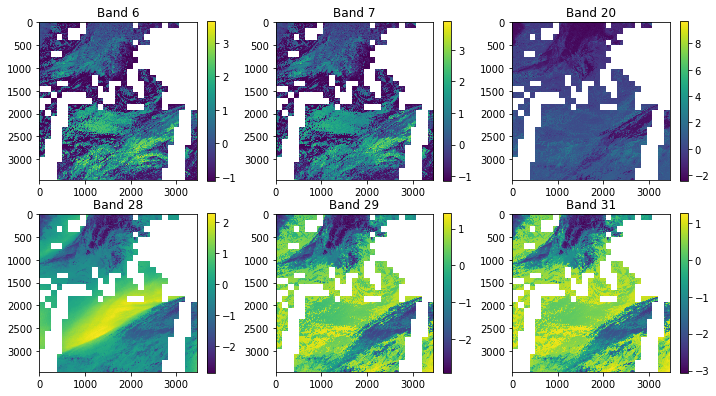

In [37]:
fig = plt.figure(figsize=(12,10))
bands = [6, 7, 20, 28, 29, 31] 
for idx in range(6):
    ax = plt.subplot(3, 3, idx+1)
    if idx<6:
        plt.imshow(normed_reconst_array[:,:,idx])
        plt.title("Band %d" % (bands[idx]))
        plt.colorbar()
    else:
        pass#plt.imshow(cloud_mask, cmap='jet')

#### Load MOD06

In [133]:
mod06_filelist = glob.glob("/home/tkurihana/scratch-midway2/clouds/analysis_mod021KM/data/MOD06/*.hdf")
mod06_filelist.sort()

In [134]:
m6dir='/home/tkurihana/scratch-midway2/clouds/analysis_mod021KM/data/MOD06'

In [135]:
m6bname='MOD06_L2.A2015335.mosaic.061.2019271230459.psmcgscs_000501379737'

In [136]:
m6bname2 = 'MOD06_L2.A2015335.mosaic.061.2019272191512.psmcgscs_000501379928'

In [137]:
hdf_filelist=[
    m6dir+'/'+str(m6bname)+'.Cloud_Water_Path.hdf',
    m6dir+'/'+str(m6bname2)+'.Cloud_Phase_Infrared_1km.hdf',
    m6dir+'/'+str(m6bname)+'.cloud_top_pressure_1km.hdf',
    m6dir+'/'+str(m6bname)+'.Cloud_Optical_Thickness.hdf',
    m6dir+'/'+str(m6bname)+'.Cloud_Effective_Radius.hdf'
]

hdf_water_path = (SD(hdf_filelist[0], SDC.READ)).select("Cloud_Water_Path")
hdf_phase_infrared = (SD(hdf_filelist[1], SDC.READ)).select("Cloud_Phase_Infrared_1km")
hdf_top_pressure = (SD(hdf_filelist[2], SDC.READ)).select("cloud_top_pressure_1km")
hdf_optical_thickness = (SD(hdf_filelist[3], SDC.READ)).select("Cloud_Optical_Thickness")
hdf_effective_radius = (SD(hdf_filelist[4], SDC.READ)).select("Cloud_Effective_Radius")

In [138]:
## decoding process
"""When you want to check how each line affects output, just comment off and process steps. 
   Initially, all process are NOT commented out. 
""" 

params = [hdf_water_path,hdf_phase_infrared,hdf_top_pressure,hdf_optical_thickness, hdf_effective_radius]
decoded = []

for jdx, hdf_sds in enumerate(params):
    array = hdf_sds.get()
    array = array.astype(np.float64)
    
    # Get FillValue index
    nan_idx = np.where( array == hdf_sds.attributes()['_FillValue'])
    if len(nan_idx) > 0:
        array[nan_idx] = np.nan
    else:
        pass
    
    # radiance offset
    offset = hdf_sds.attributes()['add_offset']
    array = array - offset
    
    # radiance scale
    scales = hdf_sds.attributes()['scale_factor']
    array = array*scales
    
    ### Error Value process
    #if str(hdf_sds) == 'hdf_optical_thickness':
    if jdx == 3:
        err_idx = np.where(array > 100.0) # optical thickness range[0,100] no unit
        array[err_idx] = np.nan
        
    decoded.append(array)

nx, ny = decoded[0].shape
d_list = [
    decoded[3].reshape(nx,ny,1),
    decoded[0].reshape(nx,ny,1),
    decoded[1].reshape(nx,ny,1),
    decoded[2].reshape(nx,ny,1),
    decoded[4].reshape(nx,ny,1)
]

/home/tkurihana/.conda/envs/tf-cpu/lib/python3.6/site-packages/ipykernel_launcher.py:31: RuntimeWarning: invalid value encountered in greater


In [139]:
mod06_img = np.concatenate(d_list, axis=2)
mod06_patches = _gen_patches(mod06_img, normalization=False, flag_nan=True)

- process mod06 patches 

In [140]:
#Find stats (mean, mode) of mod06 patches 
statistics = np.zeros((mod06_patches.shape[0],mod06_patches.shape[1],mod06_patches.shape[4]))

nx = mod06_patches.shape[0]
ny = mod06_patches.shape[1]

#Make empty arrays
optical_thickness = np.zeros((nx*128, ny*128)).astype(float)
water_path = np.zeros((nx*128, ny*128)).astype(float)
phase_infrared = np.zeros((nx*128, ny*128)).astype(float)
top_pressure = np.zeros((nx*128, ny*128)).astype(float)
effective_radius = np.zeros((nx*128, ny*128)).astype(float)

wp, pi, tp, ot, er = [], [], [], [], []

#Fill in arrays 
for param in range(mod06_patches.shape[4]):
    for i in range(0,nx):
        for j in range(0,ny):
            mean =  np.nanmean(mod06_patches[i,j,:,:,param])
            mode = stats.mode(mod06_patches[i,j,:,:,param].ravel())[0][0]
            if param == 0:
                optical_thickness[i*128: (i+1)*128, j*128 : (j+1)*128] = mean
                ot.append(mean)
                statistics[i, j, param] = mean
            elif param == 1: 
                water_path[i*128: (i+1)*128, j*128 : (j+1)*128] = mean
                wp.append(mean)
                statistics[i, j, param] = mean
            elif param == 2: 
                if np.isnan(mean):
                    mode = mean
                phase_infrared[i*128: (i+1)*128, j*128 : (j+1)*128] = mode
                pi.append(mode)
                statistics[i, j, param] = mode
            elif param == 3: 
                top_pressure[i*128: (i+1)*128, j*128 : (j+1)*128] = mean
                tp.append(mean)
                statistics[i, j, param] = mean
            else: 
                effective_radius[i*128: (i+1)*128, j*128 : (j+1)*128] = mean
                er.append(mean)
                statistics[i, j, param] = mean

/home/tkurihana/.conda/envs/tf-cpu/lib/python3.6/site-packages/ipykernel_launcher.py:20: RuntimeWarning: Mean of empty slice


-------------
## Clustering

##### clustering experiment list
- m2
    - (DONE) Agglomerative
    - kmeans
    - DBSCAN
- normed_m2
    - Agglomerative
    - kmeans
    - DBSCAN
- m4
    - (DONE) Agglomerative
    - kmeans
    - DBSCAN

-----------
### m2 model

#### m2 model clustering results visualization 

In [142]:
#Access visual data
#vis_file = '/project2/foster/clouds/data/shared/test_img/MOD02/20150628/MOD021KM.A2015179.mosaic.061.2019112165625.mcgscs_000501328368.EV_250_Aggr1km_RefSB_1.hdf'
vis_file = './data/MOD02/MOD021KM.A2015335.mosaic.061.2019272193957.psmcgscs_000501379937.EV_250_Aggr1km_RefSB_1.hdf'
vhdf = SD(vis_file, SDC.READ)
vhdf_sds = vhdf.select("EV_250_Aggr1km_RefSB")
vhdf_array, vis_band = proc_sds(vhdf_sds)

Process bands 1


/home/tkurihana/scratch-midway2/clouds/src_analysis/lib_hdfs/lib_modis02.py:92: RuntimeWarning: invalid value encountered in greater
  invalid_idx = np.where( array > 32767 )


In [145]:
n_clusters = 12

In [146]:
clouds_patches_labels, feats = compute_agl(encoder, clouds_patches_list, n_cluster=n_clusters)

In [148]:
cimg_array = reconst_img(patches, clouds_patches_labels, clouds_xy_list)

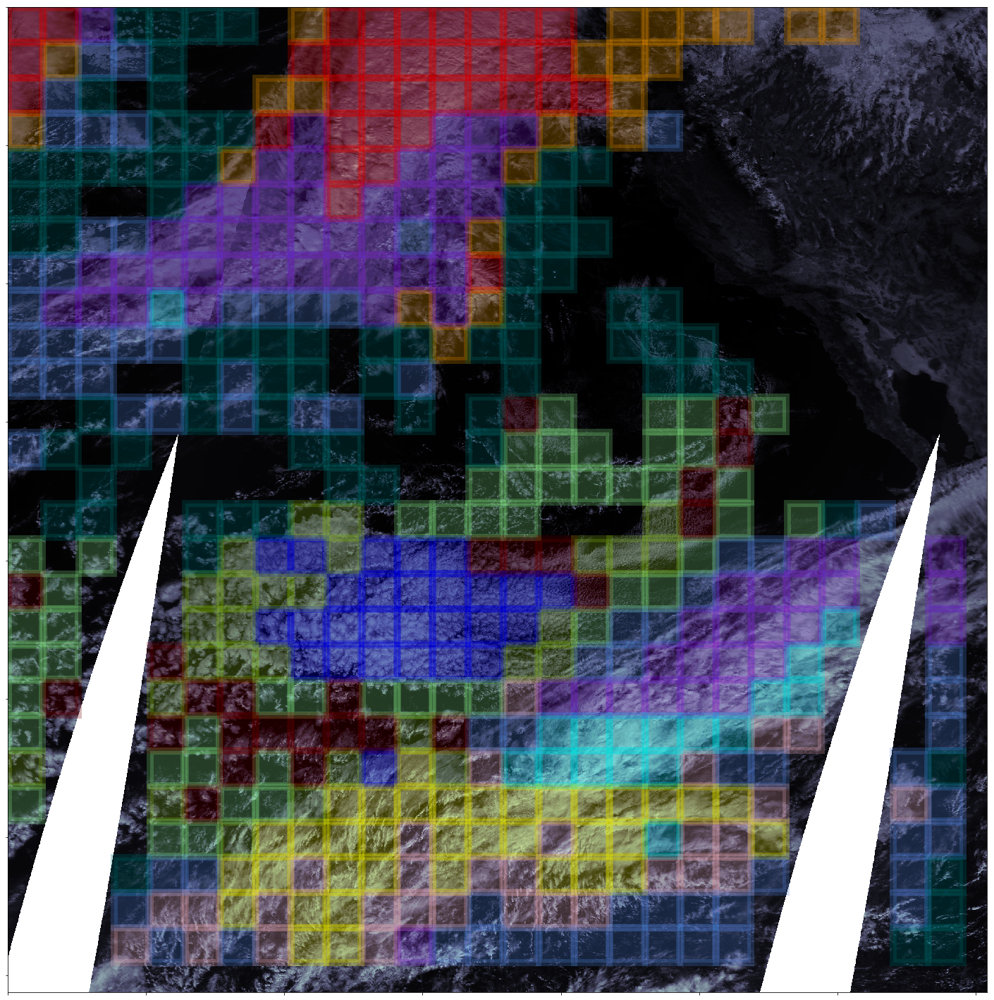

In [154]:
#Plot location of cluster patches on top of visual band image
fig = plt.figure(figsize=(20,20))

line_width = 2
SHAPE = 128,128
#colors = cmap
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'Grey']
for idx, icluster in enumerate(range(n_clusters)):
    ax = plt.subplot(1,1,1)
    plt.imshow(vhdf_array, cmap='bone')
    #ax.set_title("cluster == %d"%(icluster), fontsize=43)
    for i in range(patches.shape[0]):
        for j in range(patches.shape[1]):
            #==============================================
            if not np.isnan(cimg_array[i,j]):
                #if cimg_array[i,j] == 0 or cimg_array[i,j] == 2:
                    #======================================
                    ax.add_patch(mpl_patches.Rectangle(
                      (j * SHAPE[0] + line_width , i * SHAPE[1] + line_width ),
                      width=SHAPE[0] - line_width * 2,
                      height=SHAPE[1] - line_width * 2,
                      linewidth=10,
                      edgecolor=colors[int(cimg_array[i,j])],
                      facecolor=colors[int(cimg_array[i,j])],
                      alpha=0.05
                      ))
fig.tight_layout()
ax.set_yticklabels([])
ax.set_xticklabels([])
plt.show()
#plt.savefig("Visual_clusters_
plt.close()

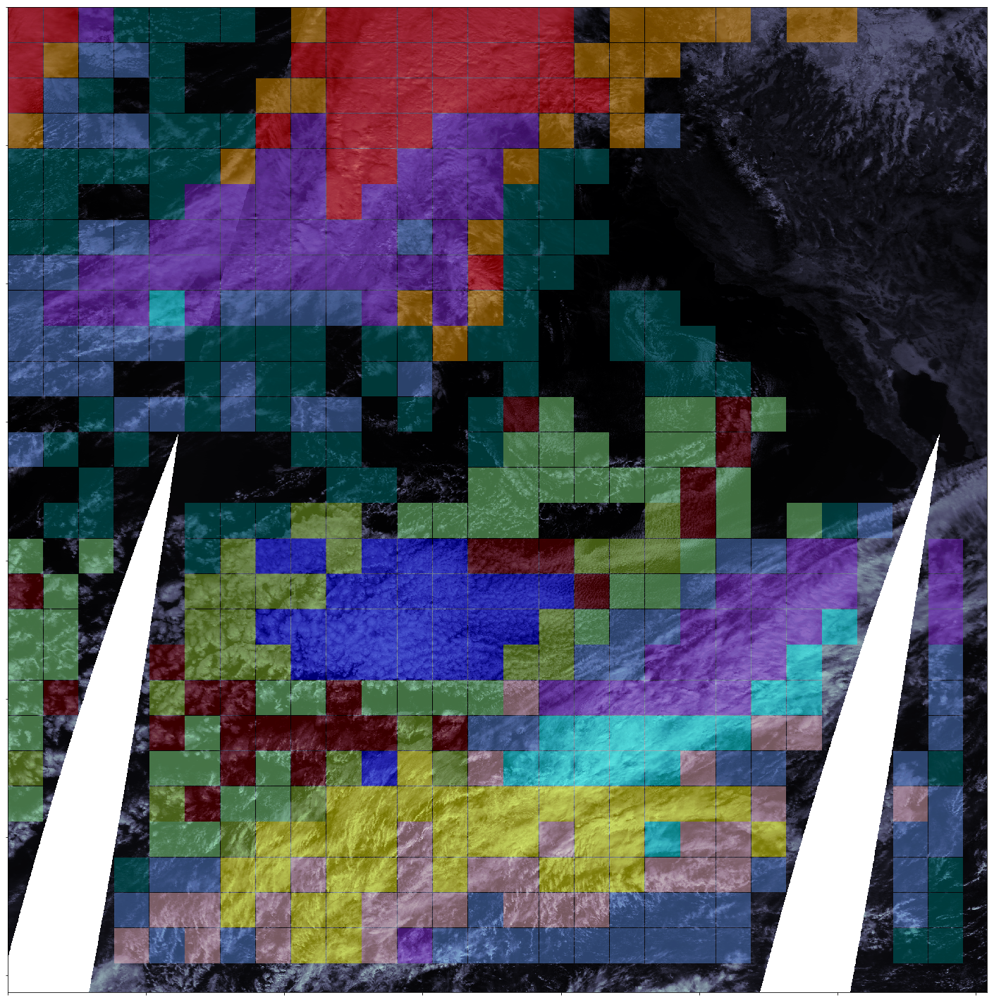

In [166]:
#Plot location of cluster patches on top of visual band image
fig = plt.figure(figsize=(20,20))

line_width = 1
SHAPE = 128,128
#colors = cmap
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'Grey']
for idx, icluster in enumerate(range(n_clusters)):
    ax = plt.subplot(1,1,1)
    plt.imshow(vhdf_array, cmap='bone')
    #ax.set_title("cluster == %d"%(icluster), fontsize=43)
    for i in range(patches.shape[0]):
        for j in range(patches.shape[1]):
            #==============================================
            if not np.isnan(cimg_array[i,j]):
                #if cimg_array[i,j] == 0 or cimg_array[i,j] == 2:
                    # linewidth = 0
                    ax.add_patch(mpl_patches.Rectangle(
                      (j * SHAPE[0] + line_width , i * SHAPE[1] + line_width ),
                      width=SHAPE[0] - line_width * 2,
                      height=SHAPE[1] - line_width * 2,
                      linewidth=0,
                      edgecolor=colors[int(cimg_array[i,j])],
                      facecolor='none',
                      alpha=0.25
                      ))
                    #======================================
                    ax.add_patch(mpl_patches.Rectangle(
                      (j * SHAPE[0] + line_width , i * SHAPE[1] + line_width ),
                      width=SHAPE[0] - line_width * 2,
                      height=SHAPE[1] - line_width * 2,
                      linewidth=0,
                      edgecolor=colors[int(cimg_array[i,j])],
                      facecolor=colors[int(cimg_array[i,j])],
                      alpha=0.05
                      ))
                    
fig.tight_layout()
ax.set_yticklabels([])
ax.set_xticklabels([])
plt.show()
#plt.savefig("Visual_clusters_
plt.close()

In [168]:
patches_ = feats
labels = clouds_patches_labels
features_2d = compute_tsne(patches_, ndim=2, nperplex=15)

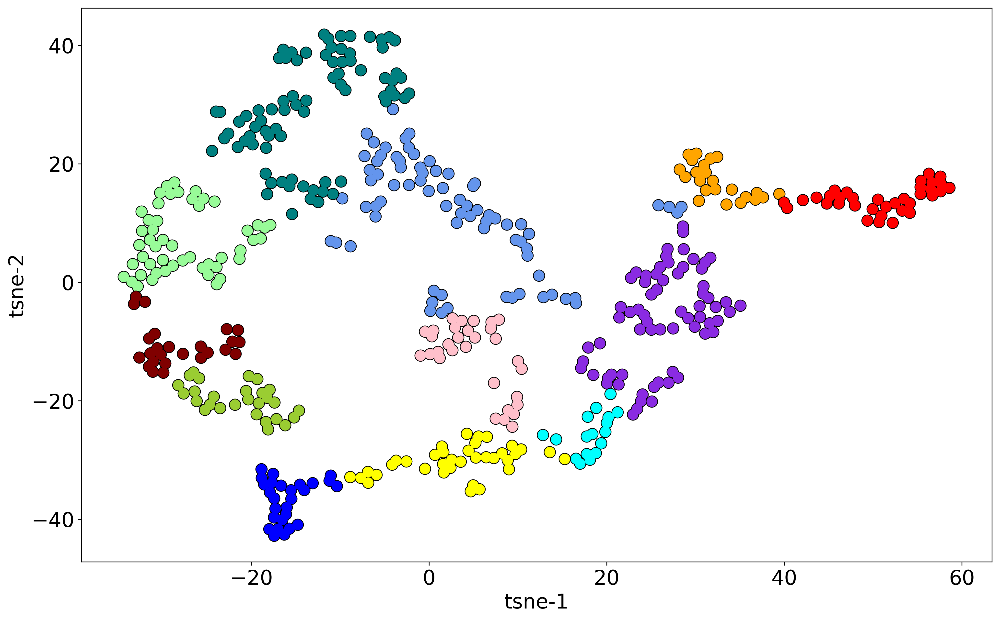

In [176]:
fig = plt.figure(figsize=(16,10), dpi=300)
for i in range(12):
    idx = np.where(labels == i)
    plt.scatter(features_2d[idx,0], features_2d[idx,1], s=120, color='black')
    plt.scatter(features_2d[idx,0], features_2d[idx,1], s=90, color=colors[i])
plt.xlabel('tsne-1', fontsize=20)
plt.ylabel('tsne-2', fontsize=20)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.show()

------------------------
##### MOD06

In [160]:
def const_clouds_array2(patches, patches2, clouds_mask, width=128, height=128, thres=0.2):
    """
    thres: range 0-1. ratio of clouds within the given patch
    dev_const_clouds_array in analysis_mode021KM/016
    """
    nx, ny = patches.shape[:2]
    print(patches.shape)
    patches_list = []
    xy_list = []
    for i in range(nx):
        for j in range(ny):
            if not np.isnan(patches2[i,j]).any():
                if np.any(clouds_mask[i*width:(i+1)*width,j*height:(j+1)*height] == 0):
                    tmp = clouds_mask[i*width:(i+1)*width,j*height:(j+1)*height]
                    nclouds = len(np.argwhere(tmp == 0))
                    if nclouds/(width*height) > thres:
                        tmp_arr = [np.nanmean(patches[i,j,:,:,0]), np.nanmean(patches[i,j,:,:,1]),
                               np.nanmean(patches[i,j,:,:,2]), np.nanmean(patches[i,j,:,:,3]),np.nanmean(patches[i,j,:,:,4])]
                        gd = 1
                        for ii in range(5):
                            if np.isnan(tmp_arr[ii]):
                                gd = 0
                        if gd:
                            patches_list.append(tmp_arr)
                            xy_list += [(i,j)]
    return patches_list, xy_list

In [161]:
mod06_patches2, mod06_xy_list = const_clouds_array2(mod06_patches[:,:,:,:,:], patches_mask, cloud_mask, thres=0.3)

(27, 27, 128, 128, 5)


In [162]:
method = AgglomerativeClustering(n_clusters=n_clusters)
_patches_labels = method.fit_predict(mod06_patches2)
mod06_array = reconst_img(patches, _patches_labels, mod06_xy_list)

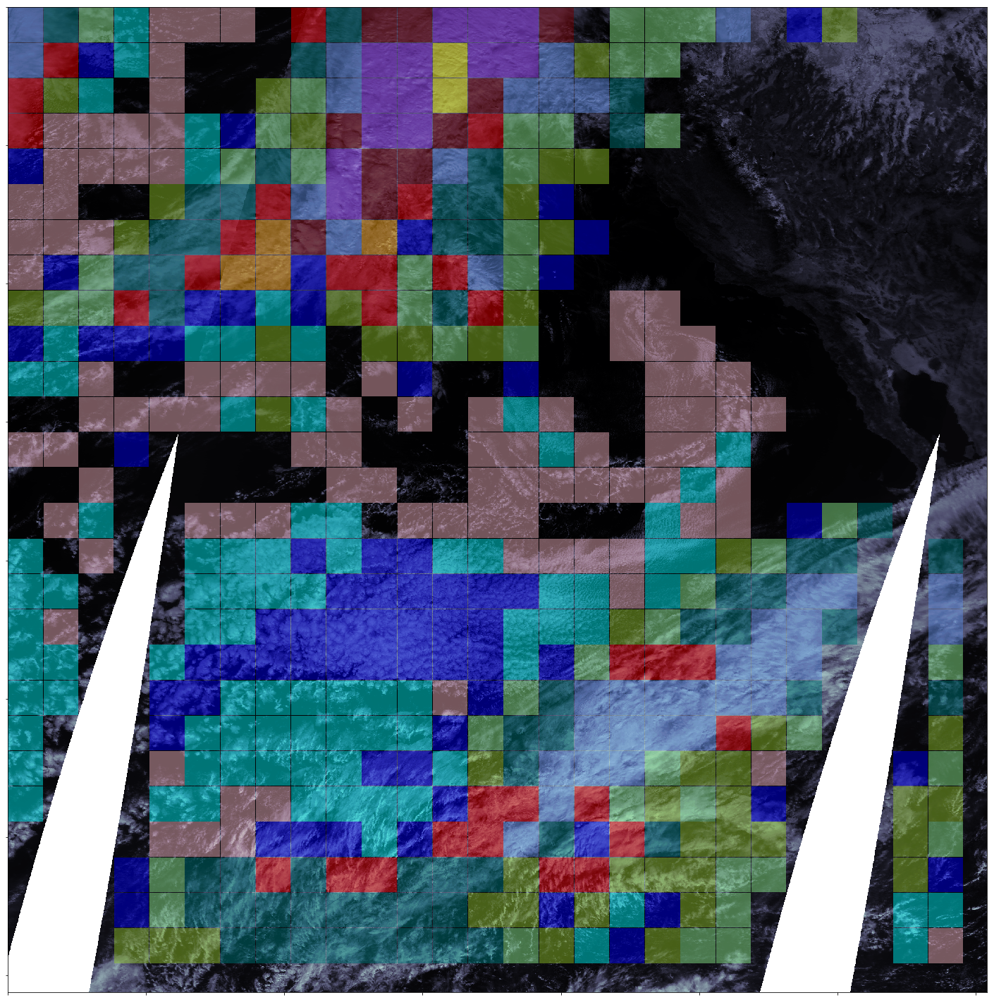

In [167]:
#Plot location of cluster patches on top of visual band image
fig = plt.figure(figsize=(20,20))

line_width = 1
SHAPE = 128,128
#colors = cmap
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'Grey']
for idx, icluster in enumerate(range(n_clusters)):
    ax = plt.subplot(1,1,1)
    plt.imshow(vhdf_array, cmap='bone')
    #ax.set_title("cluster == %d"%(icluster), fontsize=43)
    for i in range(patches.shape[0]):
        for j in range(patches.shape[1]):
            #==============================================
            if not np.isnan(mod06_array[i,j]):
                #if cimg_array[i,j] == 0 or cimg_array[i,j] == 2:
                    ax.add_patch(mpl_patches.Rectangle(
                      (j * SHAPE[0] + line_width , i * SHAPE[1] + line_width ),
                      width=SHAPE[0] - line_width * 2,
                      height=SHAPE[1] - line_width * 2,
                      linewidth=0,
                      edgecolor=colors[int(mod06_array[i,j])],
                      facecolor='none',
                      alpha=0.25
                      ))
                    #======================================
                    ax.add_patch(mpl_patches.Rectangle(
                      (j * SHAPE[0] + line_width , i * SHAPE[1] + line_width ),
                      width=SHAPE[0] - line_width * 2,
                      height=SHAPE[1] - line_width * 2,
                      linewidth=0,
                      edgecolor=colors[int(mod06_array[i,j])],
                      facecolor=colors[int(mod06_array[i,j])],
                      alpha=0.05
                      ))
                    
fig.tight_layout()
ax.set_yticklabels([])
ax.set_xticklabels([])
plt.show()
#plt.savefig("Visual_clusters_
plt.close()

#### Dendrogram
Qita [Dendrogram](https://qiita.com/sho-matsuo/items/cd7f2b66e572bf60048b)

In [177]:
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster

In [178]:
encs_list = []
for i in clouds_patches_list:
        encs = encoder.predict(i.reshape(1,128,128,6))
        encs_list += [encs.mean(axis=(1,2))]
features = np.concatenate(encs_list, axis=0)

In [180]:
Z = linkage(features,method="ward",metric="euclidean")

{'icoord': [[5.0, 5.0, 15.0, 15.0],
  [25.0, 25.0, 35.0, 35.0],
  [55.0, 55.0, 65.0, 65.0],
  [45.0, 45.0, 60.0, 60.0],
  [30.0, 30.0, 52.5, 52.5],
  [10.0, 10.0, 41.25, 41.25],
  [85.0, 85.0, 95.0, 95.0],
  [75.0, 75.0, 90.0, 90.0],
  [25.625, 25.625, 82.5, 82.5],
  [115.0, 115.0, 125.0, 125.0],
  [105.0, 105.0, 120.0, 120.0],
  [135.0, 135.0, 145.0, 145.0],
  [155.0, 155.0, 165.0, 165.0],
  [140.0, 140.0, 160.0, 160.0],
  [112.5, 112.5, 150.0, 150.0],
  [175.0, 175.0, 185.0, 185.0],
  [195.0, 195.0, 205.0, 205.0],
  [180.0, 180.0, 200.0, 200.0],
  [215.0, 215.0, 225.0, 225.0],
  [245.0, 245.0, 255.0, 255.0],
  [235.0, 235.0, 250.0, 250.0],
  [220.0, 220.0, 242.5, 242.5],
  [275.0, 275.0, 285.0, 285.0],
  [295.0, 295.0, 305.0, 305.0],
  [280.0, 280.0, 300.0, 300.0],
  [265.0, 265.0, 290.0, 290.0],
  [231.25, 231.25, 277.5, 277.5],
  [190.0, 190.0, 254.375, 254.375],
  [131.25, 131.25, 222.1875, 222.1875],
  [54.0625, 54.0625, 176.71875, 176.71875],
  [325.0, 325.0, 335.0, 335.0],
  [3

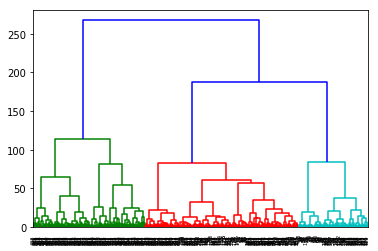

In [181]:
dendrogram(Z)

-----------------------------

#### m2 model - kmeans

In [141]:
modeldir = "/project2/foster/clouds/model/m2_02_global_2000_2018_band28_29_31"
step = 100000 # DO NOT CHANGE so far
encoder = load_model(model_dir=modeldir, epoch=step, mtype='encoder')

 Load encoder at 100000 epoch


/home/tkurihana/.conda/envs/tf-cpu/lib/python3.6/site-packages/tensorflow/python/keras/layers/core.py:791: UserWarning: models is not loaded, but a Lambda layer uses it. It may cause errors.
  , UserWarning)


In [42]:
n_clusters = 12

In [43]:
kmeans_clouds_patches_labels, kmeans_feats = compute_kmeans(
    encoder, clouds_patches_list, n_cluster=n_clusters)

In [45]:
kmeans_cimg_array = reconst_img(patches, kmeans_clouds_patches_labels, clouds_xy_list)

- Visualize kmeans-cluster

In [48]:
cimg_clearsky_array = copy.deepcopy(kmeans_cimg_array)
cimg_clearsky_array[clear_sky_idx] = n_clusters 

<bound method Figure.tight_layout of <Figure size 504x504 with 2 Axes>>

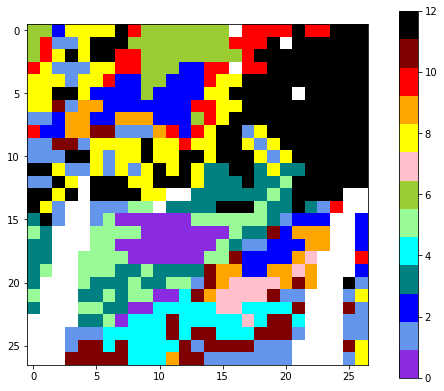

In [49]:
#Plot clusters -- cimg
fig = plt.figure(figsize=(7,7))
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'black']
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=13)
plt.imshow(cimg_clearsky_array, cmap=cmap)
#plt.title("# cloud with model " )
#plt.colorbar(orientation='horizontal')
plt.colorbar(orientation='vertical',fraction=0.047, pad=0.08)
fig.tight_layout
#plt.savefig("CImg_Clustering_With_Model")

In [86]:
patches_ = kmeans_feats
labels = kmeans_clouds_patches_labels
features_2d = compute_tsne(patches_, ndim=2, nperplex=15)

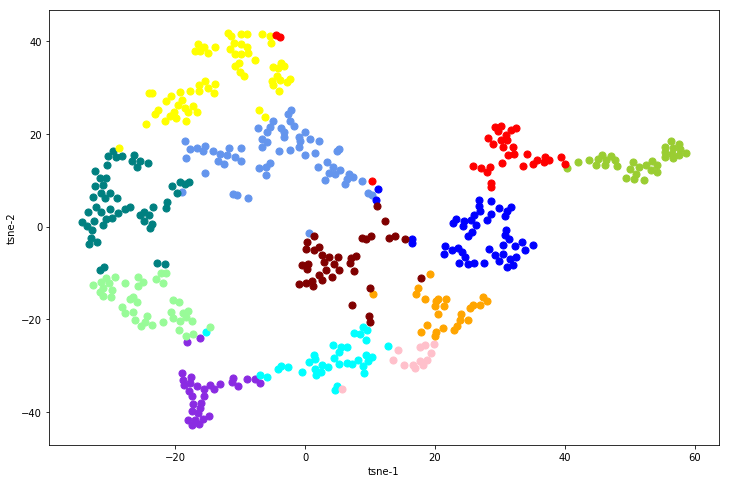

In [87]:
fig = plt.figure(figsize=(12,8))
for i in range(12):
    idx = np.where(labels == i)
    plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color=colors[i])
plt.xlabel('tsne-1')
plt.ylabel('tsne-2')
plt.show()

Make MOD06 distribution sheet

In [70]:
kmeans_cimg_physics = compute_patch_stats(kmeans_cimg_array, statistics, n_cluster=n_clusters)

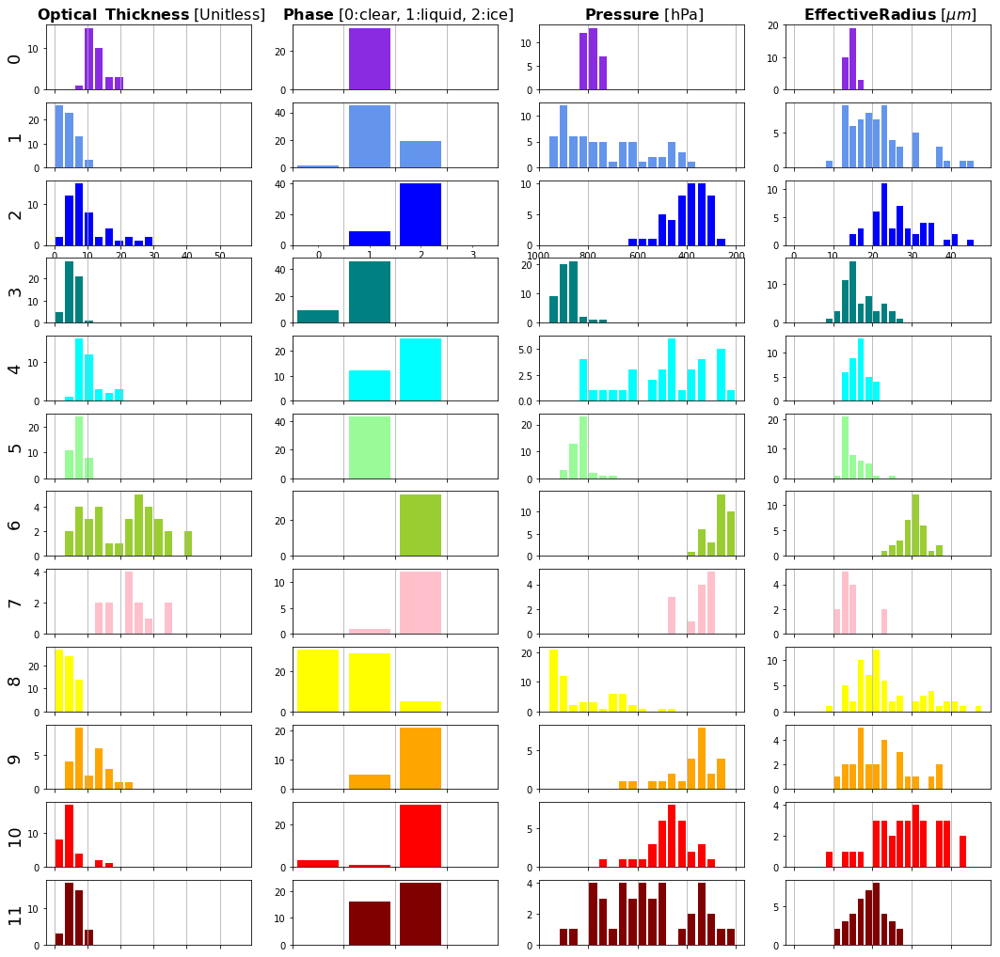

In [72]:
#Plot statistics per cluster -- cimg
titles = [
    r"$\bf{Optical \hspace{0.5} Thickness}$ [Unitless]",
    r"$\bf{Water \hspace{0.5} Path}$ [$g/m^2$]",
    r"$\bf{Phase}$ [0:clear, 1:liquid, 2:ice]",
    r"$\bf{Pressure}$ [hPa]",
    r"$\bf{Effective Radius}$ $[\mu m]$"
]
#colors = ['navy','cornflowerblue','blue','teal',
##         'aqua','palegreen', 'yellowgreen', 'pink',
 #        'yellow','orange','red','maroon']
cmap_name = 'my_list'
cmap = colors
#cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=12)
fig = plt.figure(figsize=(18,18))
it = 1
phys_colors = ['b','c','y','r','g']
for iid, i in enumerate([i for i in range(n_clusters)]):
    for k in [0,2,3,4]:
        ax = plt.subplot(n_clusters, 4, it)
        #===============================================
        # change here
        #===============================================
        tmp = kmeans_cimg_physics[i][:,k]
        #===============================================
        tmp = tmp[np.logical_not(np.isnan(tmp))]  
        
        if k == 0:
            plt.hist(tmp, bins=range(0, 60, 3), color=cmap[i],rwidth=.8)
            ax.set_ylabel("%d" % i, fontsize=18)
            #ax.yaxis.set_label_coords(-.1, 5)
            ax.set_xticks([l for l in range(0,60, 10)])
        elif k ==1 :
            plt.hist(tmp, bins=range(0, 1500, 75), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,1500,400)])
        elif k == 2:
            iidx = np.where(tmp >=5)
            ax.set_xlim(0,4)
            tmp[iidx] = 3 
            plt.hist(tmp, bins=range(0, 4, 1), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,4,1)])
            if i == 2:
                ax.set_xlim(0,4)
                ax.set_xticklabels('')
                ax.set_xticks([.5,1.5,2.5,3.5],      minor=True)
                ax.set_xticklabels(['0','1','2','3'], minor=True)
        elif k ==3:
            plt.hist(tmp, bins=range(200, 1000, 40), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(200,1001,200)])
            ax.invert_xaxis()
        elif k == 4: 
            plt.hist(tmp, bins=range(0, 50, 2), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,50,10)])
        
        if i == 0:
            ax.set_title(" %s" % titles[k],fontsize=16) 
        if i != 2:
            plt.setp(ax.get_xticklabels(), visible=False)
        it += 1
        plt.gca().xaxis.grid(True)
#plt.tight_layout()
fig.align_labels()

#plt.subplots_adjust(bottom=.4, hspace=.4)
#plt.savefig("Compare/cimg_04_20clusters_with-rad")
plt.show()
plt.close()

-------------
#### m2-model DBSCAN

/home/tkurihana/.conda/envs/tf-cpu/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in sqrt
  """


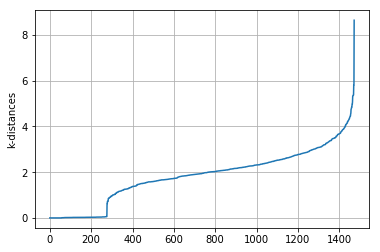

In [101]:
def k_distances2(x, k):
    dim0 = x.shape[0]
    dim1 = x.shape[1]
    p=-2*x.dot(x.T)+np.sum(x**2, axis=1).T+ np.repeat(np.sum(x**2, axis=1),dim0,axis=0).reshape(dim0,dim0)
    p = np.sqrt(p)
    p.sort(axis=1)
    p=p[:,:k]
    pm= p.flatten()
    pm= np.sort(pm)
    return p, pm
encs_list = []
for i in clouds_patches_list:
    encs = encoder.predict(i.reshape(1,128,128,6))
    encs_list += [encs.mean(axis=(1,2))]
features = np.concatenate(encs_list, axis=0)
m, m2= k_distances2(features, 3)
plt.plot(m2)
plt.ylabel("k-distances")
plt.grid(True)
plt.show()

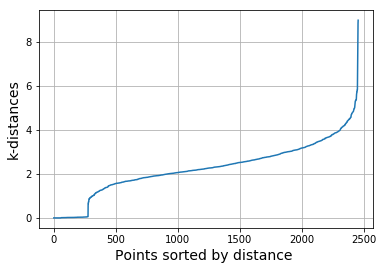

In [72]:
plt.plot(m2)
plt.ylabel("k-distances", fontsize=14)
plt.xlabel("Points sorted by distance ", fontsize=14)
plt.grid(True)
plt.show()

##### epsilon for dbscan --> 4 for m2 model

In [105]:
dbscan_clouds_patches_labels, dbscan_feats = compute_dbscan(
    encoder, clouds_patches_list, eps=2.25)

In [106]:
dbscan_clouds_patches_labels

array([ 0,  0,  1,  2,  2,  2,  2,  3,  0,  0,  0,  0,  0,  0,  0,  3,  3,
       -1, -1,  3, -1,  0, -1,  6, -1,  2,  0,  0,  0,  0,  0,  0,  0,  0,
        3,  3,  3, -1, -1,  2,  2,  3, -1,  0,  0,  0,  0, -1, -1,  0,  0,
       -1, -1,  2,  2, -1, -1,  2,  2, -1, -1,  0,  0,  0,  4,  1, -1,  3,
       -1, -1,  2,  2,  2, -1,  2,  2, -1,  4,  1,  0,  0,  4,  4,  1, -1,
        5,  5,  2,  2,  2,  4,  4,  1,  4, -1,  4,  1,  1,  1,  2,  2,  2,
        2, -1, -1, -1, -1,  4,  1,  4,  1,  1, -1,  1, -1,  5,  2,  2,  2,
        6,  1, -1, -1, -1,  1, -1, -1, -1,  1,  1,  4,  0,  5,  2, -1,  1,
        1, -1, -1, -1, -1, -1, -1, -1, -1,  3,  1, -1,  2, -1,  2,  6,  2,
       -1, -1, -1,  2,  2,  2,  2,  2,  2, -1,  2,  2,  2,  2,  2,  6,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2, -1,  7,  7,  7, -1,  7, -1,  2,  2,  2,  2,  2,  7,
        9,  7,  7, -1, -1,  2,  2,  2,  7,  9, -1, -1, -1, -1, -1,  9,  2,
        2,  2,  2,  2, -1

In [108]:
dbscan_clouds_patches_labels.max()

11

In [109]:
dbscan_cimg_array = reconst_img(patches, dbscan_clouds_patches_labels, clouds_xy_list)

In [110]:
cimg_clearsky_array = copy.deepcopy(dbscan_cimg_array)
cimg_clearsky_array[clear_sky_idx] = n_clusters 

<bound method Figure.tight_layout of <Figure size 504x504 with 2 Axes>>

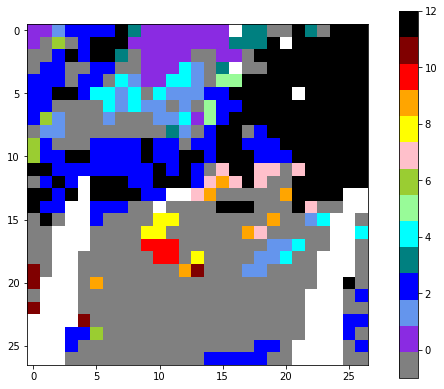

In [117]:
#Plot clusters -- cimg
fig = plt.figure(figsize=(7,7))
colors = ['gray','blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'black']
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=14)
plt.imshow(cimg_clearsky_array, cmap=cmap)
#plt.title("# cloud with model " )
#plt.colorbar(orientation='horizontal')
plt.colorbar(orientation='vertical',fraction=0.047, pad=0.08)
fig.tight_layout
#plt.savefig("CImg_Clustering_With_Model")

In [112]:
patches_ = dbscan_feats
labels = dbscan_clouds_patches_labels
features_2d = compute_tsne(patches_, ndim=2, nperplex=15)

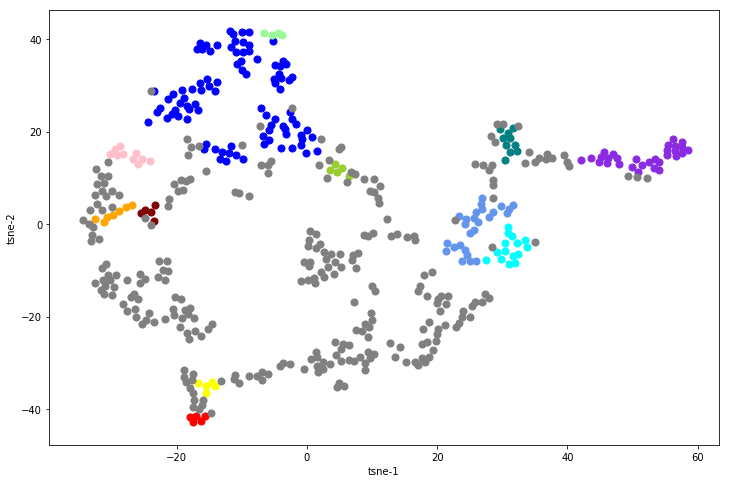

In [113]:
fig = plt.figure(figsize=(12,8))
for i in range(12):
    idx = np.where(labels == i)
    plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color=colors[i])
idx = np.where(labels == -1)
plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color='gray')
plt.xlabel('tsne-1')
plt.ylabel('tsne-2')
plt.show()

In [114]:
dbscan_cimg_physics = compute_patch_stats(dbscan_cimg_array, statistics, n_cluster=n_clusters)

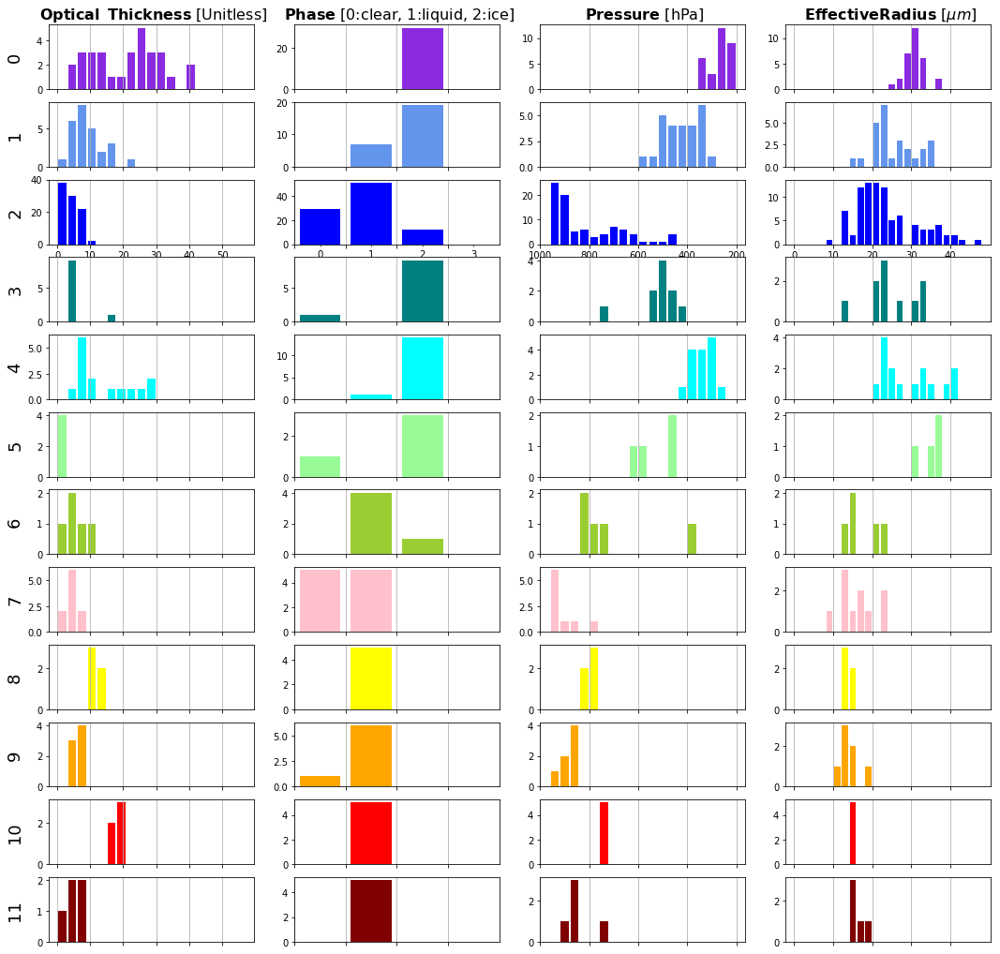

In [115]:
#Plot statistics per cluster -- cimg
titles = [
    r"$\bf{Optical \hspace{0.5} Thickness}$ [Unitless]",
    r"$\bf{Water \hspace{0.5} Path}$ [$g/m^2$]",
    r"$\bf{Phase}$ [0:clear, 1:liquid, 2:ice]",
    r"$\bf{Pressure}$ [hPa]",
    r"$\bf{Effective Radius}$ $[\mu m]$"
]
#colors = ['navy','cornflowerblue','blue','teal',
##         'aqua','palegreen', 'yellowgreen', 'pink',
 #        'yellow','orange','red','maroon']
cmap_name = 'my_list'
cmap = colors
#cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=12)
fig = plt.figure(figsize=(18,18))
it = 1
phys_colors = ['b','c','y','r','g']
for iid, i in enumerate([i for i in range(n_clusters)]):
    for k in [0,2,3,4]:
        ax = plt.subplot(n_clusters, 4, it)
        #===============================================
        # change here
        #===============================================
        tmp = dbscan_cimg_physics[i][:,k]
        #===============================================
        tmp = tmp[np.logical_not(np.isnan(tmp))]  
        
        if k == 0:
            plt.hist(tmp, bins=range(0, 60, 3), color=cmap[i],rwidth=.8)
            ax.set_ylabel("%d" % i, fontsize=18)
            #ax.yaxis.set_label_coords(-.1, 5)
            ax.set_xticks([l for l in range(0,60, 10)])
        elif k ==1 :
            plt.hist(tmp, bins=range(0, 1500, 75), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,1500,400)])
        elif k == 2:
            iidx = np.where(tmp >=5)
            ax.set_xlim(0,4)
            tmp[iidx] = 3 
            plt.hist(tmp, bins=range(0, 4, 1), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,4,1)])
            if i == 2:
                ax.set_xlim(0,4)
                ax.set_xticklabels('')
                ax.set_xticks([.5,1.5,2.5,3.5],      minor=True)
                ax.set_xticklabels(['0','1','2','3'], minor=True)
        elif k ==3:
            plt.hist(tmp, bins=range(200, 1000, 40), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(200,1001,200)])
            ax.invert_xaxis()
        elif k == 4: 
            plt.hist(tmp, bins=range(0, 50, 2), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,50,10)])
        
        if i == 0:
            ax.set_title(" %s" % titles[k],fontsize=16) 
        if i != 2:
            plt.setp(ax.get_xticklabels(), visible=False)
        it += 1
        plt.gca().xaxis.grid(True)
#plt.tight_layout()
fig.align_labels()

#plt.subplots_adjust(bottom=.4, hspace=.4)
#plt.savefig("Compare/cimg_04_20clusters_with-rad")
plt.show()
plt.close()

agglo to make tsne consistent

In [88]:
aggl_clouds_patches_labels, aggl_feats = compute_agl(
    encoder, clouds_patches_list, n_cluster=n_clusters)

In [89]:
patches_ = aggl_feats
labels = aggl_clouds_patches_labels
features_2d = compute_tsne(patches_, ndim=2, nperplex=15)

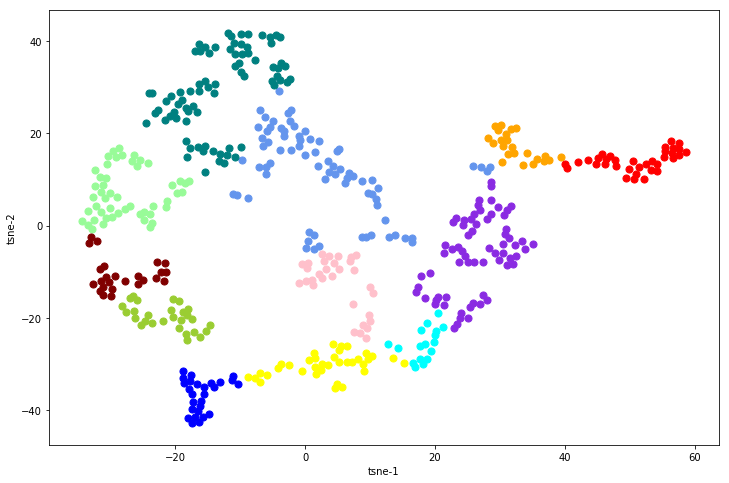

In [90]:
fig = plt.figure(figsize=(12,8))
for i in range(12):
    idx = np.where(labels == i)
    plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color=colors[i])
plt.xlabel('tsne-1')
plt.ylabel('tsne-2')
plt.show()

#### m2-model Spectral

In [93]:
n_clusters = 12

In [96]:
spec_clouds_patches_labels, spec_feats = compute_spectral(
    encoder, clouds_patches_list, n_cluster=n_clusters)

In [97]:
spec_cimg_array = reconst_img(patches, spec_clouds_patches_labels, clouds_xy_list)

In [98]:
cimg_clearsky_array = copy.deepcopy(spec_cimg_array)
cimg_clearsky_array[clear_sky_idx] = n_clusters 

<bound method Figure.tight_layout of <Figure size 504x504 with 2 Axes>>

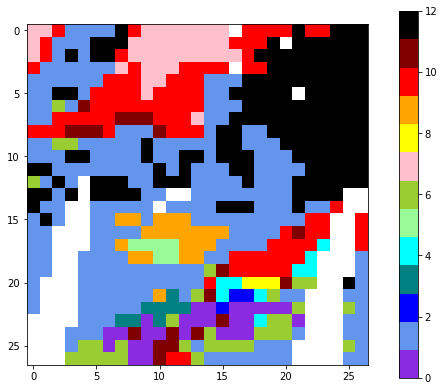

In [99]:
#Plot clusters -- cimg
fig = plt.figure(figsize=(7,7))
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'black']
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=13)
plt.imshow(cimg_clearsky_array, cmap=cmap)
#plt.title("# cloud with model " )
#plt.colorbar(orientation='horizontal')
plt.colorbar(orientation='vertical',fraction=0.047, pad=0.08)
fig.tight_layout
#plt.savefig("CImg_Clustering_With_Model")

In [100]:
patches_ = spec_feats
labels = spec_clouds_patches_labels
features_2d = compute_tsne(patches_, ndim=2, nperplex=15)

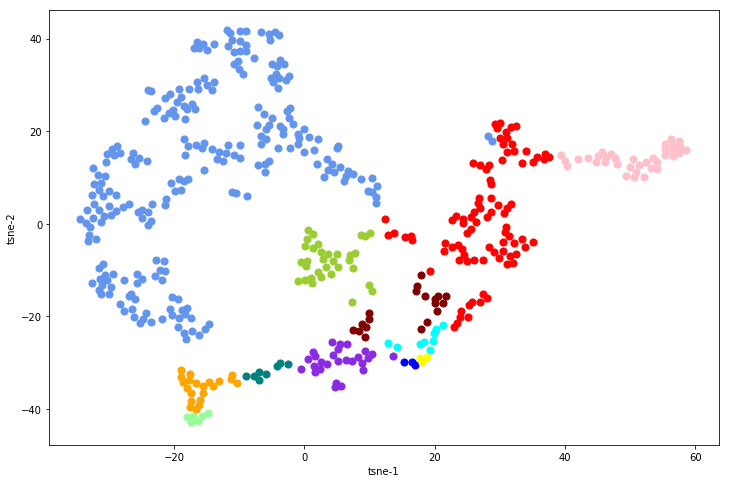

In [101]:
fig = plt.figure(figsize=(12,8))
for i in range(12):
    idx = np.where(labels == i)
    plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color=colors[i])
plt.xlabel('tsne-1')
plt.ylabel('tsne-2')
plt.show()

In [102]:
spec_cimg_physics = compute_patch_stats(spec_cimg_array, statistics, n_cluster=n_clusters)

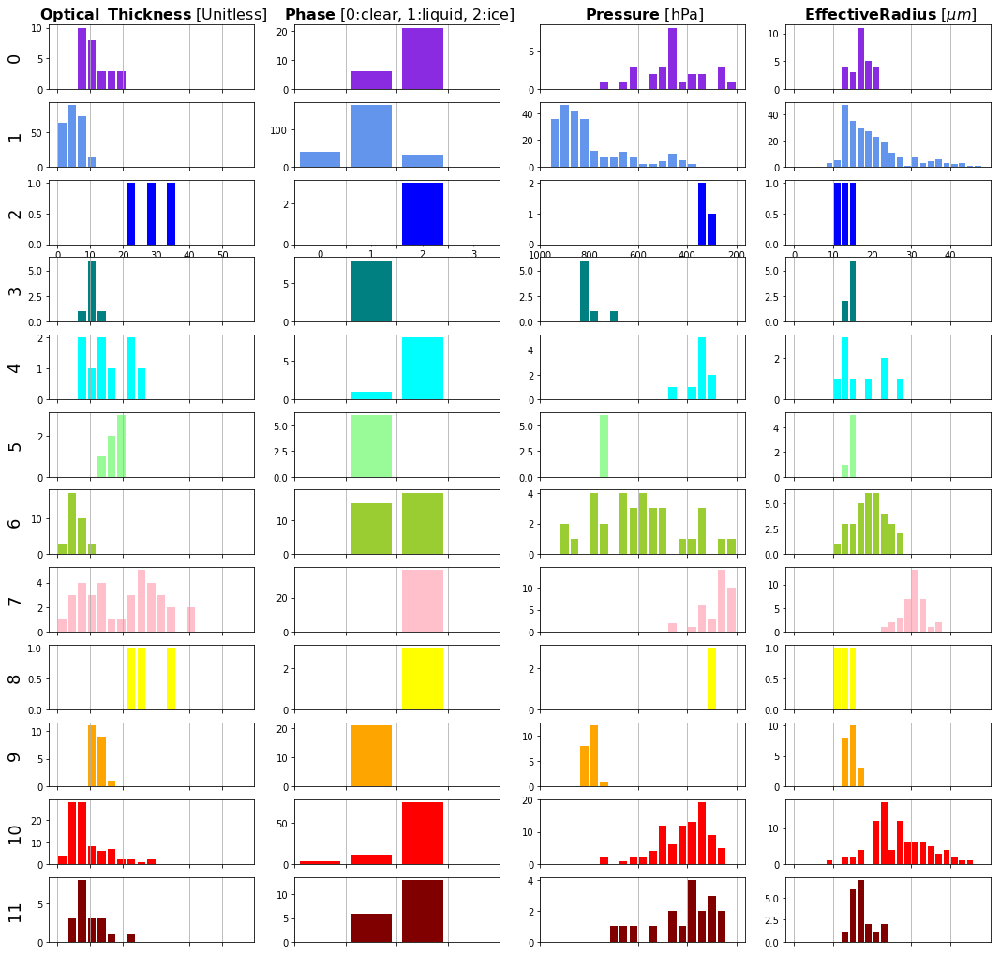

In [103]:
#Plot statistics per cluster -- cimg
titles = [
    r"$\bf{Optical \hspace{0.5} Thickness}$ [Unitless]",
    r"$\bf{Water \hspace{0.5} Path}$ [$g/m^2$]",
    r"$\bf{Phase}$ [0:clear, 1:liquid, 2:ice]",
    r"$\bf{Pressure}$ [hPa]",
    r"$\bf{Effective Radius}$ $[\mu m]$"
]
#colors = ['navy','cornflowerblue','blue','teal',
##         'aqua','palegreen', 'yellowgreen', 'pink',
 #        'yellow','orange','red','maroon']
cmap_name = 'my_list'
cmap = colors
#cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=12)
fig = plt.figure(figsize=(18,18))
it = 1
phys_colors = ['b','c','y','r','g']
for iid, i in enumerate([i for i in range(n_clusters)]):
    for k in [0,2,3,4]:
        ax = plt.subplot(n_clusters, 4, it)
        #===============================================
        # change here
        #===============================================
        tmp = spec_cimg_physics[i][:,k]
        #===============================================
        tmp = tmp[np.logical_not(np.isnan(tmp))]  
        
        if k == 0:
            plt.hist(tmp, bins=range(0, 60, 3), color=cmap[i],rwidth=.8)
            ax.set_ylabel("%d" % i, fontsize=18)
            #ax.yaxis.set_label_coords(-.1, 5)
            ax.set_xticks([l for l in range(0,60, 10)])
        elif k ==1 :
            plt.hist(tmp, bins=range(0, 1500, 75), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,1500,400)])
        elif k == 2:
            iidx = np.where(tmp >=5)
            ax.set_xlim(0,4)
            tmp[iidx] = 3 
            plt.hist(tmp, bins=range(0, 4, 1), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,4,1)])
            if i == 2:
                ax.set_xlim(0,4)
                ax.set_xticklabels('')
                ax.set_xticks([.5,1.5,2.5,3.5],      minor=True)
                ax.set_xticklabels(['0','1','2','3'], minor=True)
        elif k ==3:
            plt.hist(tmp, bins=range(200, 1000, 40), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(200,1001,200)])
            ax.invert_xaxis()
        elif k == 4: 
            plt.hist(tmp, bins=range(0, 50, 2), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,50,10)])
        
        if i == 0:
            ax.set_title(" %s" % titles[k],fontsize=16) 
        if i != 2:
            plt.setp(ax.get_xticklabels(), visible=False)
        it += 1
        plt.gca().xaxis.grid(True)
#plt.tight_layout()
fig.align_labels()

#plt.subplots_adjust(bottom=.4, hspace=.4)
#plt.savefig("Compare/cimg_04_20clusters_with-rad")
plt.show()
plt.close()

---------------
### m2 normed model

In [217]:
modeldir = "/project2/foster/clouds/model/m2_02_global_2000_2018_band28_29_31_normed"
step = 100000 # DO NOT CHANGE so far
encoder = load_model(model_dir=modeldir, epoch=step, mtype='encoder')

 Load encoder at 100000 epoch


/home/tkurihana/.conda/envs/tf-cpu/lib/python3.6/site-packages/tensorflow/python/keras/layers/core.py:791: UserWarning: models is not loaded, but a Lambda layer uses it. It may cause errors.
  , UserWarning)


#### m2-norm - agglomerative

In [218]:
n_clusters = 12

In [219]:
agl_clouds_patches_labels, agl_feats = compute_agl(
    encoder, normed_clouds_patches_list, n_cluster=n_clusters)

In [220]:
normed_agl_cimg_array = reconst_img(normed_patches, agl_clouds_patches_labels, normed_clouds_xy_list)

In [221]:
cimg_clearsky_array = copy.deepcopy(normed_agl_cimg_array)
cimg_clearsky_array[clear_sky_idx] = n_clusters 

<bound method Figure.tight_layout of <Figure size 504x504 with 2 Axes>>

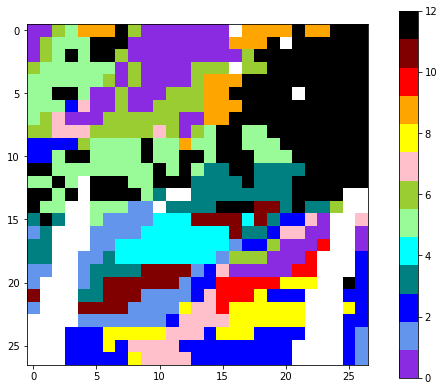

In [109]:
#Plot clusters -- cimg
fig = plt.figure(figsize=(7,7))
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'black']
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=13)
plt.imshow(cimg_clearsky_array, cmap=cmap)
#plt.title("# cloud with model " )
#plt.colorbar(orientation='horizontal')
plt.colorbar(orientation='vertical',fraction=0.047, pad=0.08)
fig.tight_layout
#plt.savefig("CImg_Clustering_With_Model")

In [114]:
patches_ = agl_feats
labels = agl_clouds_patches_labels
features_2d = compute_tsne(patches_, ndim=2, nperplex=15)

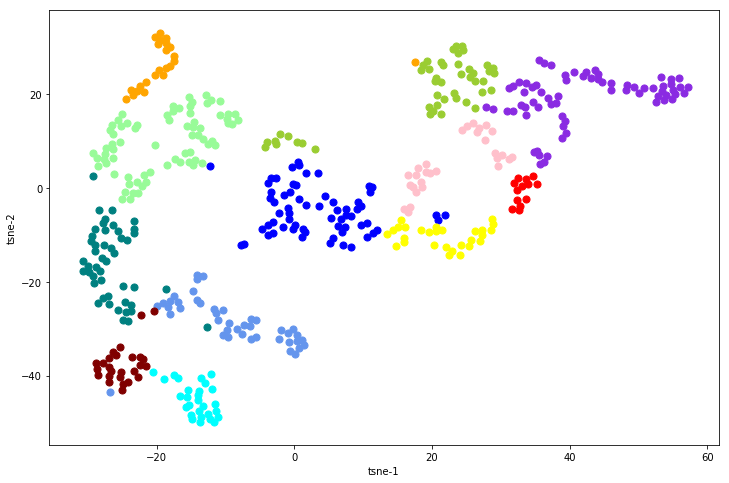

In [115]:
fig = plt.figure(figsize=(12,8))
for i in range(12):
    idx = np.where(labels == i)
    plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color=colors[i])
plt.xlabel('tsne-1')
plt.ylabel('tsne-2')
plt.show()

In [223]:
agl_cimg_physics = compute_patch_stats(normed_agl_cimg_array, statistics, n_cluster=n_clusters)

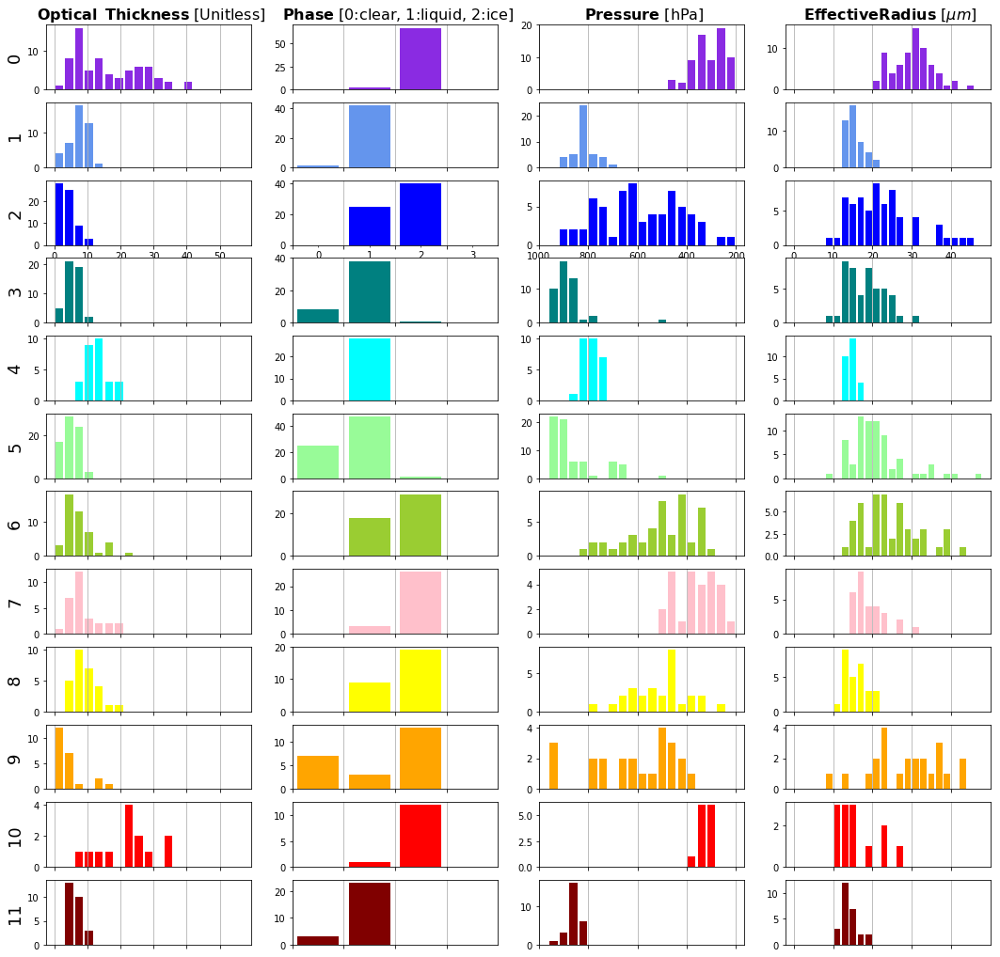

In [113]:
#Plot statistics per cluster -- cimg
titles = [
    r"$\bf{Optical \hspace{0.5} Thickness}$ [Unitless]",
    r"$\bf{Water \hspace{0.5} Path}$ [$g/m^2$]",
    r"$\bf{Phase}$ [0:clear, 1:liquid, 2:ice]",
    r"$\bf{Pressure}$ [hPa]",
    r"$\bf{Effective Radius}$ $[\mu m]$"
]
#colors = ['navy','cornflowerblue','blue','teal',
##         'aqua','palegreen', 'yellowgreen', 'pink',
 #        'yellow','orange','red','maroon']
cmap_name = 'my_list'
cmap = colors
#cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=12)
fig = plt.figure(figsize=(18,18))
it = 1
phys_colors = ['b','c','y','r','g']
for iid, i in enumerate([i for i in range(n_clusters)]):
    for k in [0,2,3,4]:
        ax = plt.subplot(n_clusters, 4, it)
        #===============================================
        # change here
        #===============================================
        tmp = agl_cimg_physics[i][:,k]
        #===============================================
        tmp = tmp[np.logical_not(np.isnan(tmp))]  
        
        if k == 0:
            plt.hist(tmp, bins=range(0, 60, 3), color=cmap[i],rwidth=.8)
            ax.set_ylabel("%d" % i, fontsize=18)
            #ax.yaxis.set_label_coords(-.1, 5)
            ax.set_xticks([l for l in range(0,60, 10)])
        elif k ==1 :
            plt.hist(tmp, bins=range(0, 1500, 75), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,1500,400)])
        elif k == 2:
            iidx = np.where(tmp >=5)
            ax.set_xlim(0,4)
            tmp[iidx] = 3 
            plt.hist(tmp, bins=range(0, 4, 1), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,4,1)])
            if i == 2:
                ax.set_xlim(0,4)
                ax.set_xticklabels('')
                ax.set_xticks([.5,1.5,2.5,3.5],      minor=True)
                ax.set_xticklabels(['0','1','2','3'], minor=True)
        elif k ==3:
            plt.hist(tmp, bins=range(200, 1000, 40), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(200,1001,200)])
            ax.invert_xaxis()
        elif k == 4: 
            plt.hist(tmp, bins=range(0, 50, 2), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,50,10)])
        
        if i == 0:
            ax.set_title(" %s" % titles[k],fontsize=16) 
        if i != 2:
            plt.setp(ax.get_xticklabels(), visible=False)
        it += 1
        plt.gca().xaxis.grid(True)
#plt.tight_layout()
fig.align_labels()

#plt.subplots_adjust(bottom=.4, hspace=.4)
#plt.savefig("Compare/cimg_04_20clusters_with-rad")
plt.show()
plt.close()

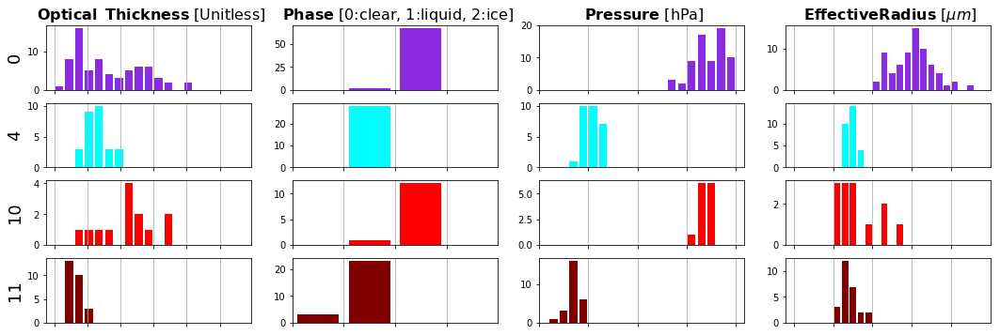

In [225]:
#Plot statistics per cluster -- cimg
titles = [
    r"$\bf{Optical \hspace{0.5} Thickness}$ [Unitless]",
    r"$\bf{Water \hspace{0.5} Path}$ [$g/m^2$]",
    r"$\bf{Phase}$ [0:clear, 1:liquid, 2:ice]",
    r"$\bf{Pressure}$ [hPa]",
    r"$\bf{Effective Radius}$ $[\mu m]$"
]
#colors = ['navy','cornflowerblue','blue','teal',
##         'aqua','palegreen', 'yellowgreen', 'pink',
 #        'yellow','orange','red','maroon']
cmap_name = 'my_list'
cmap = colors
#cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=12)
fig = plt.figure(figsize=(18,18))
it = 1
phys_colors = ['b','c','y','r','g']
for iid, i in enumerate([0,4,10,11]):
    for k in [0,2,3,4]:
        ax = plt.subplot(n_clusters, 4, it)
        #===============================================
        # change here
        #===============================================
        tmp = agl_cimg_physics[i][:,k]
        #===============================================
        tmp = tmp[np.logical_not(np.isnan(tmp))]  
        
        if k == 0:
            plt.hist(tmp, bins=range(0, 60, 3), color=cmap[i],rwidth=.8)
            ax.set_ylabel("%d" % i, fontsize=18)
            #ax.yaxis.set_label_coords(-.1, 5)
            ax.set_xticks([l for l in range(0,60, 10)])
        elif k ==1 :
            plt.hist(tmp, bins=range(0, 1500, 75), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,1500,400)])
        elif k == 2:
            iidx = np.where(tmp >=5)
            ax.set_xlim(0,4)
            tmp[iidx] = 3 
            plt.hist(tmp, bins=range(0, 4, 1), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,4,1)])
            if i == 2:
                ax.set_xlim(0,4)
                ax.set_xticklabels('')
                ax.set_xticks([.5,1.5,2.5,3.5],      minor=True)
                ax.set_xticklabels(['0','1','2','3'], minor=True)
        elif k ==3:
            plt.hist(tmp, bins=range(200, 1000, 40), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(200,1001,200)])
            ax.invert_xaxis()
        elif k == 4: 
            plt.hist(tmp, bins=range(0, 50, 2), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,50,10)])
        
        if i == 0:
            ax.set_title(" %s" % titles[k],fontsize=16) 
        if i != 2:
            plt.setp(ax.get_xticklabels(), visible=False)
        it += 1
        plt.gca().xaxis.grid(True)
#plt.tight_layout()
fig.align_labels()

#plt.subplots_adjust(bottom=.4, hspace=.4)
#plt.savefig("Compare/cimg_04_20clusters_with-rad")
plt.show()
plt.close()

#### m2-norm DBSCAN

/home/tkurihana/.conda/envs/tf-cpu/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in sqrt
  """


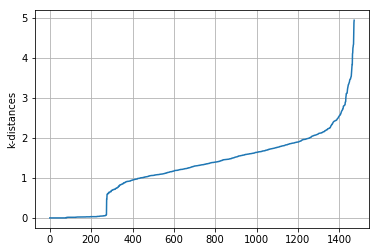

In [122]:
def k_distances2(x, k):
    dim0 = x.shape[0]
    dim1 = x.shape[1]
    p=-2*x.dot(x.T)+np.sum(x**2, axis=1).T+ np.repeat(np.sum(x**2, axis=1),dim0,axis=0).reshape(dim0,dim0)
    p = np.sqrt(p)
    p.sort(axis=1)
    p=p[:,:k]
    pm= p.flatten()
    pm= np.sort(pm)
    return p, pm
encs_list = []
for i in normed_clouds_patches_list:
    encs = encoder.predict(i.reshape(1,128,128,6))
    encs_list += [encs.mean(axis=(1,2))]
features = np.concatenate(encs_list, axis=0)
m, m2= k_distances2(features, 3)
plt.plot(m2)
plt.ylabel("k-distances")
plt.grid(True)
plt.show()

In [149]:
dbscan_clouds_patches_labels, dbscan_feats = compute_dbscan(
    encoder, normed_clouds_patches_list, eps=0.7225)

In [150]:
dbscan_clouds_patches_labels.max()

11

In [151]:
dbscan_cimg_array = reconst_img(normed_patches, dbscan_clouds_patches_labels, normed_clouds_xy_list)

In [152]:
cimg_clearsky_array = copy.deepcopy(dbscan_cimg_array)
cimg_clearsky_array[clear_sky_idx] = n_clusters 

<bound method Figure.tight_layout of <Figure size 504x504 with 2 Axes>>

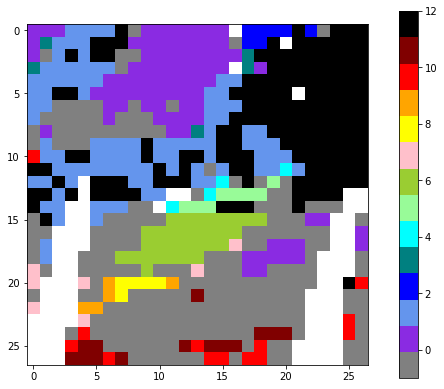

In [154]:
#Plot clusters -- cimg
fig = plt.figure(figsize=(7,7))
colors = ['gray','blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'black']
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=14)
plt.imshow(cimg_clearsky_array, cmap=cmap)
#plt.title("# cloud with model " )
#plt.colorbar(orientation='horizontal')
plt.colorbar(orientation='vertical',fraction=0.047, pad=0.08)
fig.tight_layout
#plt.savefig("CImg_Clustering_With_Model")

In [155]:
patches_ = dbscan_feats
labels = dbscan_clouds_patches_labels
features_2d = compute_tsne(patches_, ndim=2, nperplex=15)

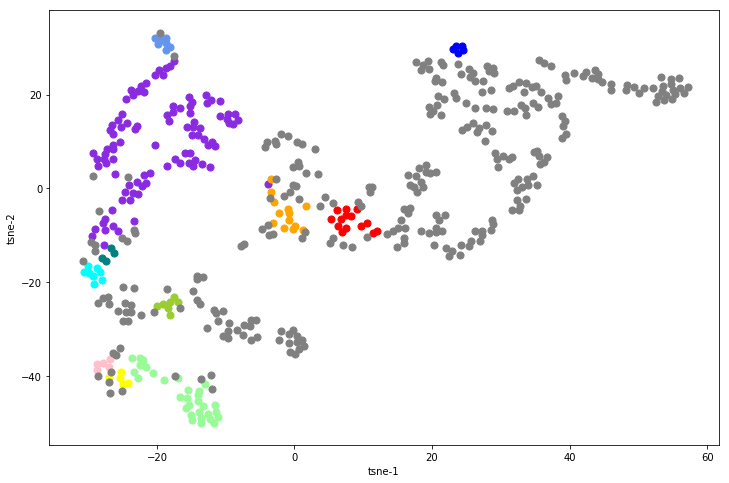

In [156]:
fig = plt.figure(figsize=(12,8))
for i in range(12):
    idx = np.where(labels == i)
    plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color=colors[i])
idx = np.where(labels == -1)
plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color='gray')
plt.xlabel('tsne-1')
plt.ylabel('tsne-2')
plt.show()

In [157]:
dbscan_cimg_physics = compute_patch_stats(dbscan_cimg_array, statistics, n_cluster=n_clusters)

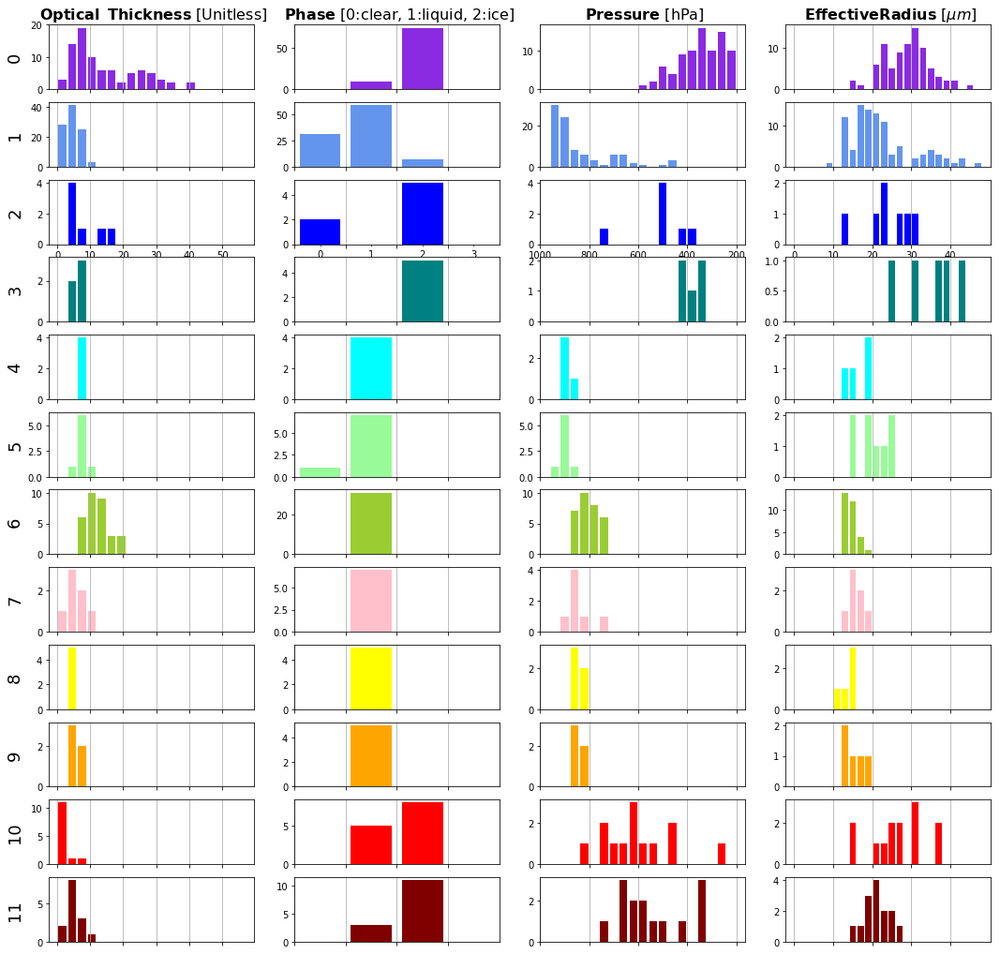

In [159]:
#Plot statistics per cluster -- cimg
titles = [
    r"$\bf{Optical \hspace{0.5} Thickness}$ [Unitless]",
    r"$\bf{Water \hspace{0.5} Path}$ [$g/m^2$]",
    r"$\bf{Phase}$ [0:clear, 1:liquid, 2:ice]",
    r"$\bf{Pressure}$ [hPa]",
    r"$\bf{Effective Radius}$ $[\mu m]$"
]
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'black']
#colors = ['navy','cornflowerblue','blue','teal',
##         'aqua','palegreen', 'yellowgreen', 'pink',
 #        'yellow','orange','red','maroon']
cmap_name = 'my_list'
cmap = colors
#cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=12)
fig = plt.figure(figsize=(18,18))
it = 1
phys_colors = ['b','c','y','r','g']
for iid, i in enumerate([i for i in range(n_clusters)]):
    for k in [0,2,3,4]:
        ax = plt.subplot(n_clusters, 4, it)
        #===============================================
        # change here
        #===============================================
        tmp = dbscan_cimg_physics[i][:,k]
        #===============================================
        tmp = tmp[np.logical_not(np.isnan(tmp))]  
        
        if k == 0:
            plt.hist(tmp, bins=range(0, 60, 3), color=cmap[i],rwidth=.8)
            ax.set_ylabel("%d" % i, fontsize=18)
            #ax.yaxis.set_label_coords(-.1, 5)
            ax.set_xticks([l for l in range(0,60, 10)])
        elif k ==1 :
            plt.hist(tmp, bins=range(0, 1500, 75), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,1500,400)])
        elif k == 2:
            iidx = np.where(tmp >=5)
            ax.set_xlim(0,4)
            tmp[iidx] = 3 
            plt.hist(tmp, bins=range(0, 4, 1), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,4,1)])
            if i == 2:
                ax.set_xlim(0,4)
                ax.set_xticklabels('')
                ax.set_xticks([.5,1.5,2.5,3.5],      minor=True)
                ax.set_xticklabels(['0','1','2','3'], minor=True)
        elif k ==3:
            plt.hist(tmp, bins=range(200, 1000, 40), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(200,1001,200)])
            ax.invert_xaxis()
        elif k == 4: 
            plt.hist(tmp, bins=range(0, 50, 2), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,50,10)])
        
        if i == 0:
            ax.set_title(" %s" % titles[k],fontsize=16) 
        if i != 2:
            plt.setp(ax.get_xticklabels(), visible=False)
        it += 1
        plt.gca().xaxis.grid(True)
#plt.tight_layout()
fig.align_labels()

#plt.subplots_adjust(bottom=.4, hspace=.4)
#plt.savefig("Compare/cimg_04_20clusters_with-rad")
plt.show()
plt.close()

#### m2 - norm - kmeans

In [116]:
n_clusters = 12

In [117]:
kmeans_clouds_patches_labels, kmeans_feats = compute_kmeans(
    encoder, normed_clouds_patches_list, n_cluster=n_clusters)

In [118]:
normed_kmeans_cimg_array = reconst_img(normed_patches, kmeans_clouds_patches_labels, normed_clouds_xy_list)

In [119]:
cimg_clearsky_array = copy.deepcopy(normed_kmeans_cimg_array)
cimg_clearsky_array[clear_sky_idx] = n_clusters 

<bound method Figure.tight_layout of <Figure size 504x504 with 2 Axes>>

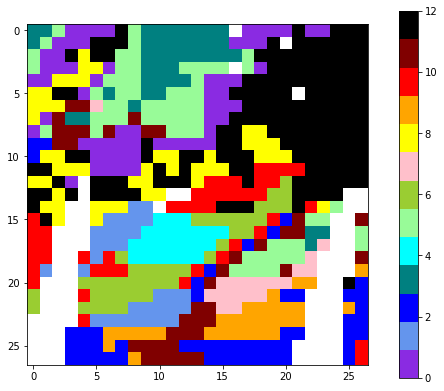

In [120]:
#Plot clusters -- cimg
fig = plt.figure(figsize=(7,7))
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'black']
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=13)
plt.imshow(cimg_clearsky_array, cmap=cmap)
#plt.title("# cloud with model " )
#plt.colorbar(orientation='horizontal')
plt.colorbar(orientation='vertical',fraction=0.047, pad=0.08)
fig.tight_layout
#plt.savefig("CImg_Clustering_With_Model")

In [121]:
patches_ = kmeans_feats
labels = kmeans_clouds_patches_labels
features_2d = compute_tsne(patches_, ndim=2, nperplex=15)

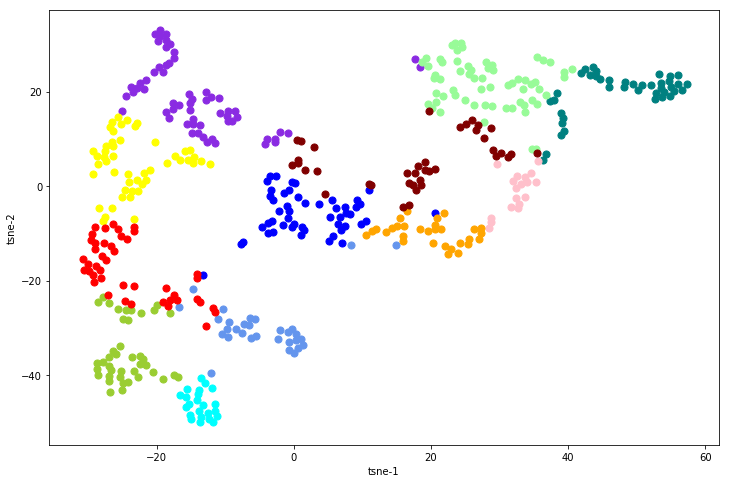

In [122]:
fig = plt.figure(figsize=(12,8))
for i in range(12):
    idx = np.where(labels == i)
    plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color=colors[i])
plt.xlabel('tsne-1')
plt.ylabel('tsne-2')
plt.show()

In [124]:
kmeans_cimg_physics = compute_patch_stats(normed_kmeans_cimg_array, statistics, n_cluster=n_clusters)

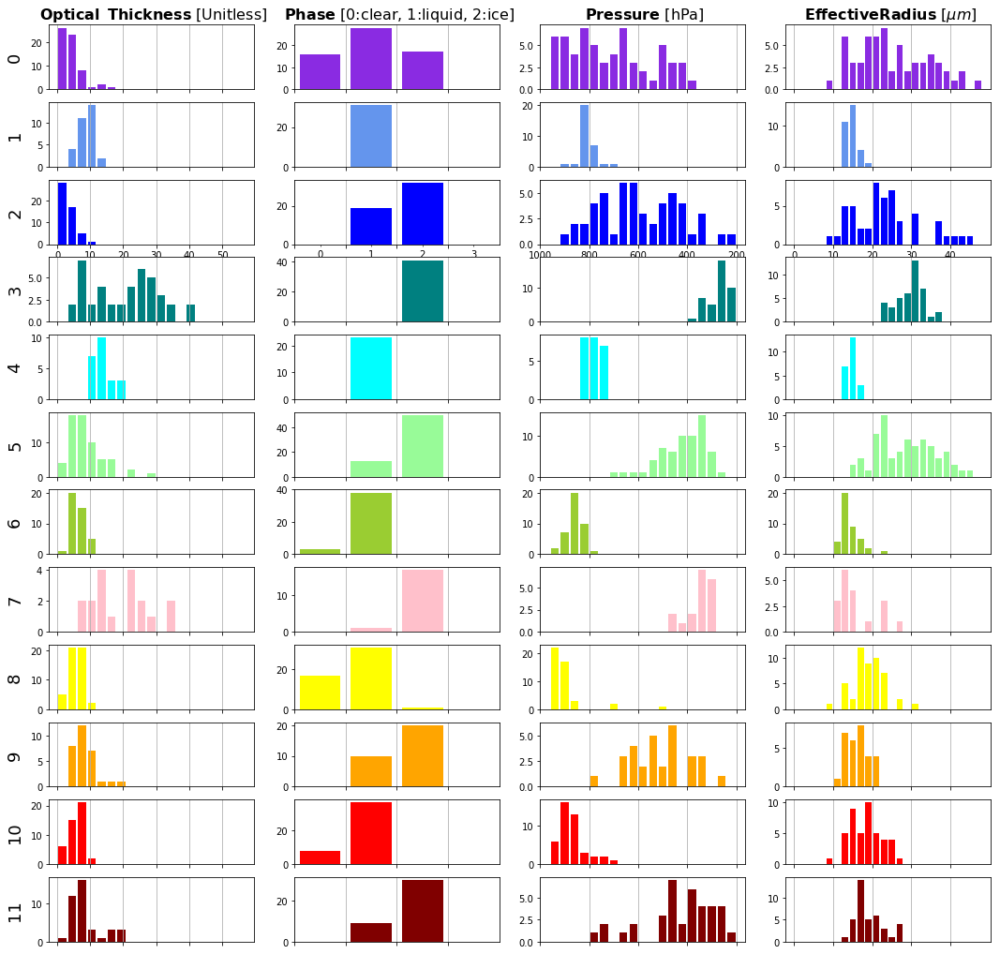

In [125]:
#Plot statistics per cluster -- cimg
titles = [
    r"$\bf{Optical \hspace{0.5} Thickness}$ [Unitless]",
    r"$\bf{Water \hspace{0.5} Path}$ [$g/m^2$]",
    r"$\bf{Phase}$ [0:clear, 1:liquid, 2:ice]",
    r"$\bf{Pressure}$ [hPa]",
    r"$\bf{Effective Radius}$ $[\mu m]$"
]
#colors = ['navy','cornflowerblue','blue','teal',
##         'aqua','palegreen', 'yellowgreen', 'pink',
 #        'yellow','orange','red','maroon']
cmap_name = 'my_list'
cmap = colors
#cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=12)
fig = plt.figure(figsize=(18,18))
it = 1
phys_colors = ['b','c','y','r','g']
for iid, i in enumerate([i for i in range(n_clusters)]):
    for k in [0,2,3,4]:
        ax = plt.subplot(n_clusters, 4, it)
        #===============================================
        # change here
        #===============================================
        tmp = kmeans_cimg_physics[i][:,k]
        #===============================================
        tmp = tmp[np.logical_not(np.isnan(tmp))]  
        
        if k == 0:
            plt.hist(tmp, bins=range(0, 60, 3), color=cmap[i],rwidth=.8)
            ax.set_ylabel("%d" % i, fontsize=18)
            #ax.yaxis.set_label_coords(-.1, 5)
            ax.set_xticks([l for l in range(0,60, 10)])
        elif k ==1 :
            plt.hist(tmp, bins=range(0, 1500, 75), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,1500,400)])
        elif k == 2:
            iidx = np.where(tmp >=5)
            ax.set_xlim(0,4)
            tmp[iidx] = 3 
            plt.hist(tmp, bins=range(0, 4, 1), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,4,1)])
            if i == 2:
                ax.set_xlim(0,4)
                ax.set_xticklabels('')
                ax.set_xticks([.5,1.5,2.5,3.5],      minor=True)
                ax.set_xticklabels(['0','1','2','3'], minor=True)
        elif k ==3:
            plt.hist(tmp, bins=range(200, 1000, 40), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(200,1001,200)])
            ax.invert_xaxis()
        elif k == 4: 
            plt.hist(tmp, bins=range(0, 50, 2), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,50,10)])
        
        if i == 0:
            ax.set_title(" %s" % titles[k],fontsize=16) 
        if i != 2:
            plt.setp(ax.get_xticklabels(), visible=False)
        it += 1
        plt.gca().xaxis.grid(True)
#plt.tight_layout()
fig.align_labels()

#plt.subplots_adjust(bottom=.4, hspace=.4)
#plt.savefig("Compare/cimg_04_20clusters_with-rad")
plt.show()
plt.close()

#### m2 - norm spectral

In [126]:
n_clusters = 12

In [127]:
spec_clouds_patches_labels, spec_feats = compute_spectral(
    encoder, normed_clouds_patches_list, n_cluster=n_clusters)

In [128]:
normed_spec_cimg_array = reconst_img(normed_patches, spec_clouds_patches_labels, normed_clouds_xy_list)

In [129]:
cimg_clearsky_array = copy.deepcopy(normed_spec_cimg_array)
cimg_clearsky_array[clear_sky_idx] = n_clusters 

<bound method Figure.tight_layout of <Figure size 504x504 with 2 Axes>>

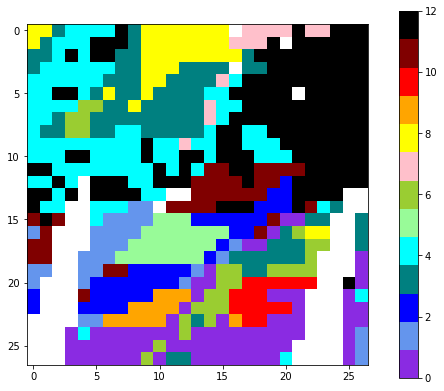

In [130]:
#Plot clusters -- cimg
fig = plt.figure(figsize=(7,7))
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'black']
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=13)
plt.imshow(cimg_clearsky_array, cmap=cmap)
#plt.title("# cloud with model " )
#plt.colorbar(orientation='horizontal')
plt.colorbar(orientation='vertical',fraction=0.047, pad=0.08)
fig.tight_layout
#plt.savefig("CImg_Clustering_With_Model")

In [131]:
patches_ = spec_feats
labels = spec_clouds_patches_labels
features_2d = compute_tsne(patches_, ndim=2, nperplex=15)

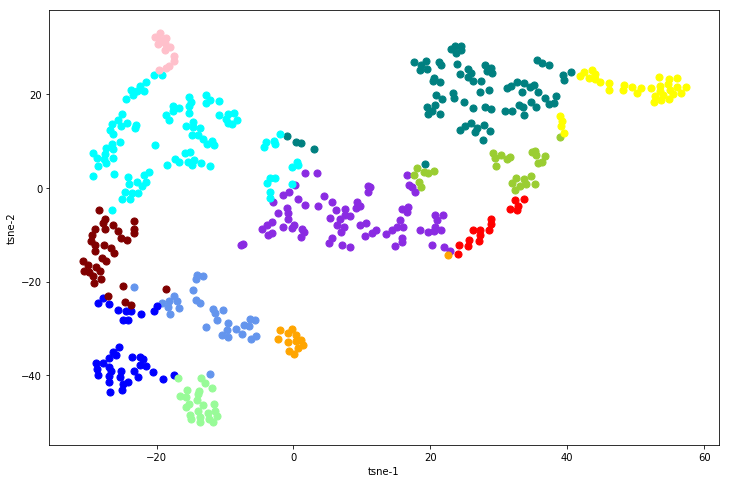

In [132]:
fig = plt.figure(figsize=(12,8))
for i in range(12):
    idx = np.where(labels == i)
    plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color=colors[i])
plt.xlabel('tsne-1')
plt.ylabel('tsne-2')
plt.show()

--------------------
### m2-04 model (no - normed)

In [160]:
modeldir = "/project2/foster/clouds/model/m2_04_global_2000_2018_band28_29_31"
step = 100000 # DO NOT CHANGE so far
encoder = load_model(model_dir=modeldir, epoch=step, mtype='encoder')

 Load encoder at 100000 epoch


/home/tkurihana/.conda/envs/tf-cpu/lib/python3.6/site-packages/tensorflow/python/keras/layers/core.py:791: UserWarning: models is not loaded, but a Lambda layer uses it. It may cause errors.
  , UserWarning)


#### m4 - agl

In [15]:
n_clusters = 12

In [46]:
agl_clouds_patches_labels, agl_feats = compute_agl(
    encoder, clouds_patches_list, n_cluster=n_clusters)

In [47]:
agl_cimg_array = reconst_img(patches, agl_clouds_patches_labels, clouds_xy_list)

In [48]:
cimg_clearsky_array = copy.deepcopy(agl_cimg_array)
cimg_clearsky_array[clear_sky_idx] = n_clusters 

<bound method Figure.tight_layout of <Figure size 504x504 with 2 Axes>>

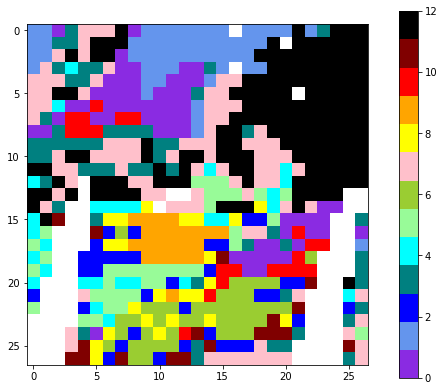

In [49]:
#Plot clusters -- cimg
fig = plt.figure(figsize=(7,7))
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'black']
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=13)
plt.imshow(cimg_clearsky_array, cmap=cmap)
#plt.title("# cloud with model " )
#plt.colorbar(orientation='horizontal')
plt.colorbar(orientation='vertical',fraction=0.047, pad=0.08)
fig.tight_layout
#plt.savefig("CImg_Clustering_With_Model")

In [50]:
patches_ = agl_feats
labels = agl_clouds_patches_labels
features_2d = compute_tsne(patches_, ndim=2, nperplex=15)

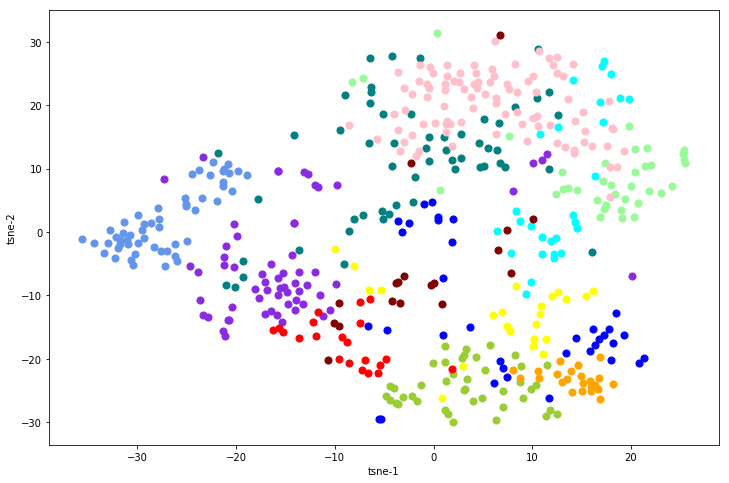

In [51]:
fig = plt.figure(figsize=(12,8))
for i in range(12):
    idx = np.where(labels == i)
    plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color=colors[i])
plt.xlabel('tsne-1')
plt.ylabel('tsne-2')
plt.show()

In [52]:
agl_cimg_physics = compute_patch_stats(agl_cimg_array, statistics, n_cluster=n_clusters)

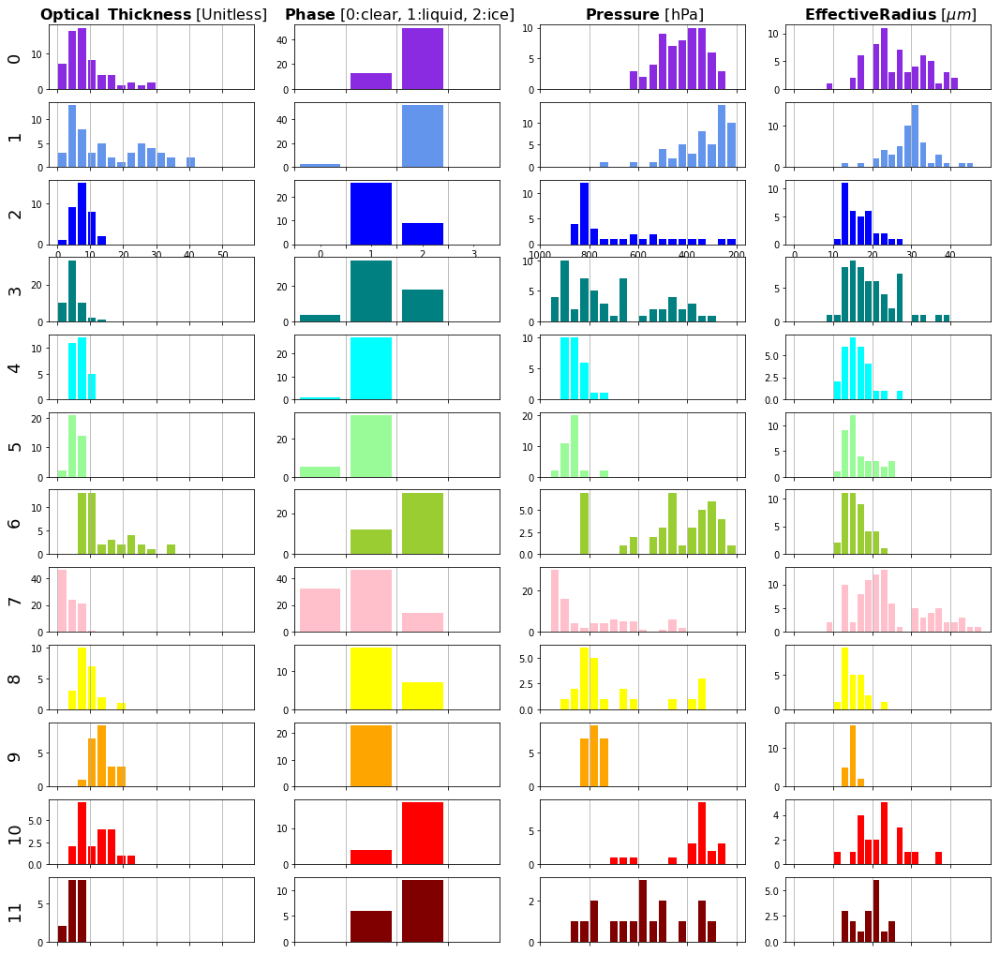

In [53]:
#Plot statistics per cluster -- cimg
titles = [
    r"$\bf{Optical \hspace{0.5} Thickness}$ [Unitless]",
    r"$\bf{Water \hspace{0.5} Path}$ [$g/m^2$]",
    r"$\bf{Phase}$ [0:clear, 1:liquid, 2:ice]",
    r"$\bf{Pressure}$ [hPa]",
    r"$\bf{Effective Radius}$ $[\mu m]$"
]
#colors = ['navy','cornflowerblue','blue','teal',
##         'aqua','palegreen', 'yellowgreen', 'pink',
 #        'yellow','orange','red','maroon']
cmap_name = 'my_list'
cmap = colors
#cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=12)
fig = plt.figure(figsize=(18,18))
it = 1
phys_colors = ['b','c','y','r','g']
for iid, i in enumerate([i for i in range(n_clusters)]):
    for k in [0,2,3,4]:
        ax = plt.subplot(n_clusters, 4, it)
        #===============================================
        # change here
        #===============================================
        tmp = agl_cimg_physics[i][:,k]
        #===============================================
        tmp = tmp[np.logical_not(np.isnan(tmp))]  
        
        if k == 0:
            plt.hist(tmp, bins=range(0, 60, 3), color=cmap[i],rwidth=.8)
            ax.set_ylabel("%d" % i, fontsize=18)
            #ax.yaxis.set_label_coords(-.1, 5)
            ax.set_xticks([l for l in range(0,60, 10)])
        elif k ==1 :
            plt.hist(tmp, bins=range(0, 1500, 75), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,1500,400)])
        elif k == 2:
            iidx = np.where(tmp >=5)
            ax.set_xlim(0,4)
            tmp[iidx] = 3 
            plt.hist(tmp, bins=range(0, 4, 1), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,4,1)])
            if i == 2:
                ax.set_xlim(0,4)
                ax.set_xticklabels('')
                ax.set_xticks([.5,1.5,2.5,3.5],      minor=True)
                ax.set_xticklabels(['0','1','2','3'], minor=True)
        elif k ==3:
            plt.hist(tmp, bins=range(200, 1000, 40), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(200,1001,200)])
            ax.invert_xaxis()
        elif k == 4: 
            plt.hist(tmp, bins=range(0, 50, 2), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,50,10)])
        
        if i == 0:
            ax.set_title(" %s" % titles[k],fontsize=16) 
        if i != 2:
            plt.setp(ax.get_xticklabels(), visible=False)
        it += 1
        plt.gca().xaxis.grid(True)
#plt.tight_layout()
fig.align_labels()

#plt.subplots_adjust(bottom=.4, hspace=.4)
#plt.savefig("Compare/cimg_04_20clusters_with-rad")
plt.show()
plt.close()

#### m4-kmeans

In [33]:
n_clusters = 12

In [34]:
kmeans_clouds_patches_labels, kmeans_feats = compute_kmeans(
    encoder, clouds_patches_list, n_cluster=n_clusters)

In [35]:
kmeans_cimg_array = reconst_img(patches, kmeans_clouds_patches_labels, clouds_xy_list)

In [36]:
cimg_clearsky_array = copy.deepcopy(kmeans_cimg_array)
cimg_clearsky_array[clear_sky_idx] = n_clusters 

<bound method Figure.tight_layout of <Figure size 504x504 with 2 Axes>>

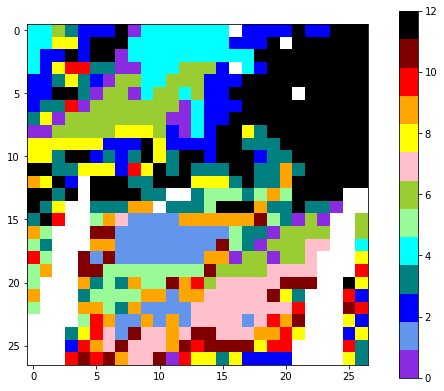

In [37]:
#Plot clusters -- cimg
fig = plt.figure(figsize=(7,7))
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'black']
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=13)
plt.imshow(cimg_clearsky_array, cmap=cmap)
#plt.title("# cloud with model " )
#plt.colorbar(orientation='horizontal')
plt.colorbar(orientation='vertical',fraction=0.047, pad=0.08)
fig.tight_layout
#plt.savefig("CImg_Clustering_With_Model")

In [42]:
patches_ = kmeans_feats
labels = kmeans_clouds_patches_labels
features_2d = compute_tsne(patches_, ndim=2, nperplex=15)

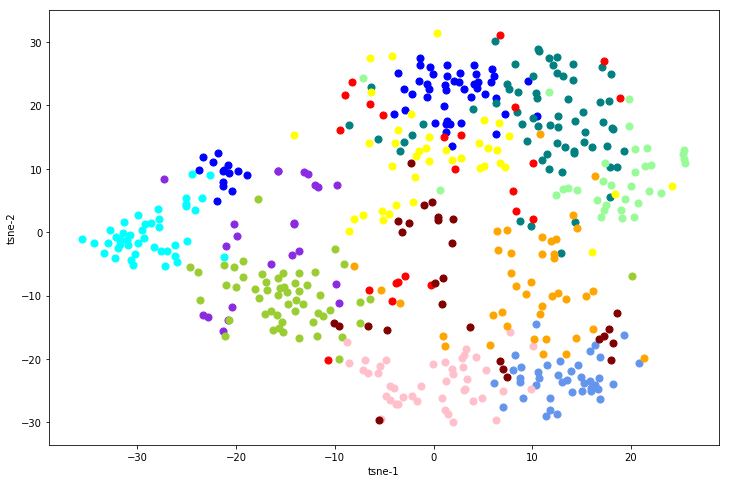

In [43]:
fig = plt.figure(figsize=(12,8))
for i in range(12):
    idx = np.where(labels == i)
    plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color=colors[i])
plt.xlabel('tsne-1')
plt.ylabel('tsne-2')
plt.show()

In [44]:
kmeans_cimg_physics = compute_patch_stats(kmeans_cimg_array, statistics, n_cluster=n_clusters)

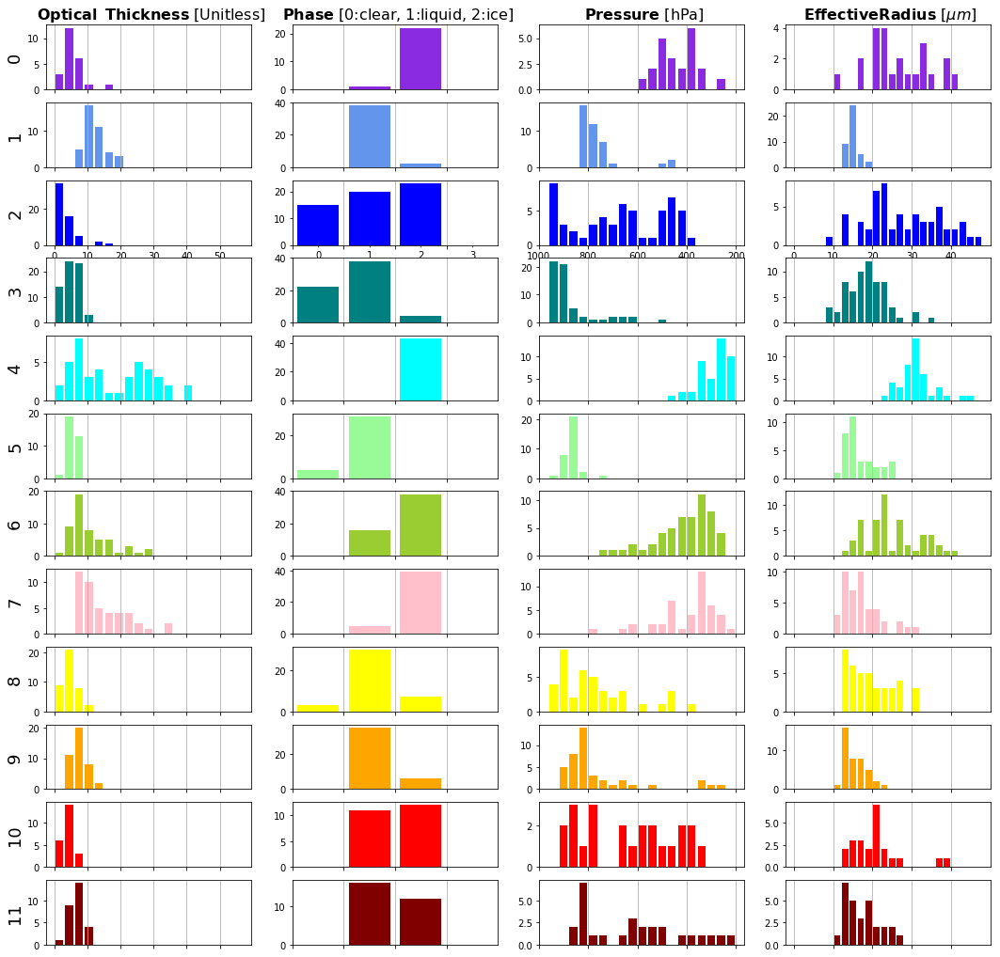

In [45]:
#Plot statistics per cluster -- cimg
titles = [
    r"$\bf{Optical \hspace{0.5} Thickness}$ [Unitless]",
    r"$\bf{Water \hspace{0.5} Path}$ [$g/m^2$]",
    r"$\bf{Phase}$ [0:clear, 1:liquid, 2:ice]",
    r"$\bf{Pressure}$ [hPa]",
    r"$\bf{Effective Radius}$ $[\mu m]$"
]
#colors = ['navy','cornflowerblue','blue','teal',
##         'aqua','palegreen', 'yellowgreen', 'pink',
 #        'yellow','orange','red','maroon']
cmap_name = 'my_list'
cmap = colors
#cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=12)
fig = plt.figure(figsize=(18,18))
it = 1
phys_colors = ['b','c','y','r','g']
for iid, i in enumerate([i for i in range(n_clusters)]):
    for k in [0,2,3,4]:
        ax = plt.subplot(n_clusters, 4, it)
        #===============================================
        # change here
        #===============================================
        tmp = kmeans_cimg_physics[i][:,k]
        #===============================================
        tmp = tmp[np.logical_not(np.isnan(tmp))]  
        
        if k == 0:
            plt.hist(tmp, bins=range(0, 60, 3), color=cmap[i],rwidth=.8)
            ax.set_ylabel("%d" % i, fontsize=18)
            #ax.yaxis.set_label_coords(-.1, 5)
            ax.set_xticks([l for l in range(0,60, 10)])
        elif k ==1 :
            plt.hist(tmp, bins=range(0, 1500, 75), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,1500,400)])
        elif k == 2:
            iidx = np.where(tmp >=5)
            ax.set_xlim(0,4)
            tmp[iidx] = 3 
            plt.hist(tmp, bins=range(0, 4, 1), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,4,1)])
            if i == 2:
                ax.set_xlim(0,4)
                ax.set_xticklabels('')
                ax.set_xticks([.5,1.5,2.5,3.5],      minor=True)
                ax.set_xticklabels(['0','1','2','3'], minor=True)
        elif k ==3:
            plt.hist(tmp, bins=range(200, 1000, 40), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(200,1001,200)])
            ax.invert_xaxis()
        elif k == 4: 
            plt.hist(tmp, bins=range(0, 50, 2), color=cmap[i],rwidth=.8)
            ax.set_xticks([l for l in range(0,50,10)])
        
        if i == 0:
            ax.set_title(" %s" % titles[k],fontsize=16) 
        if i != 2:
            plt.setp(ax.get_xticklabels(), visible=False)
        it += 1
        plt.gca().xaxis.grid(True)
#plt.tight_layout()
fig.align_labels()

#plt.subplots_adjust(bottom=.4, hspace=.4)
#plt.savefig("Compare/cimg_04_20clusters_with-rad")
plt.show()
plt.close()

#### m4 - spec

In [54]:
n_clusters = 12

In [55]:
spec_clouds_patches_labels, spec_feats = compute_spectral(
    encoder, clouds_patches_list, n_cluster=n_clusters)

In [56]:
spec_cimg_array = reconst_img(patches, spec_clouds_patches_labels, clouds_xy_list)

In [57]:
cimg_clearsky_array = copy.deepcopy(spec_cimg_array)
cimg_clearsky_array[clear_sky_idx] = n_clusters 

<bound method Figure.tight_layout of <Figure size 504x504 with 2 Axes>>

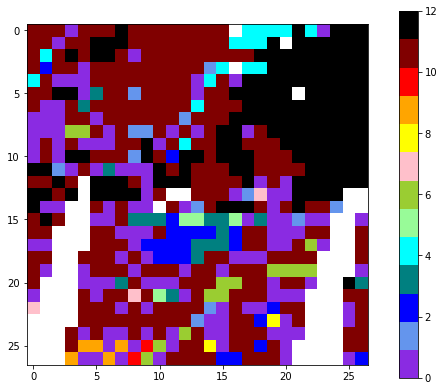

In [58]:
#Plot clusters -- cimg
fig = plt.figure(figsize=(7,7))
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'black']
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=13)
plt.imshow(cimg_clearsky_array, cmap=cmap)
#plt.title("# cloud with model " )
#plt.colorbar(orientation='horizontal')
plt.colorbar(orientation='vertical',fraction=0.047, pad=0.08)
fig.tight_layout
#plt.savefig("CImg_Clustering_With_Model")

In [59]:
patches_ = spec_feats
labels = spec_clouds_patches_labels
features_2d = compute_tsne(patches_, ndim=2, nperplex=15)

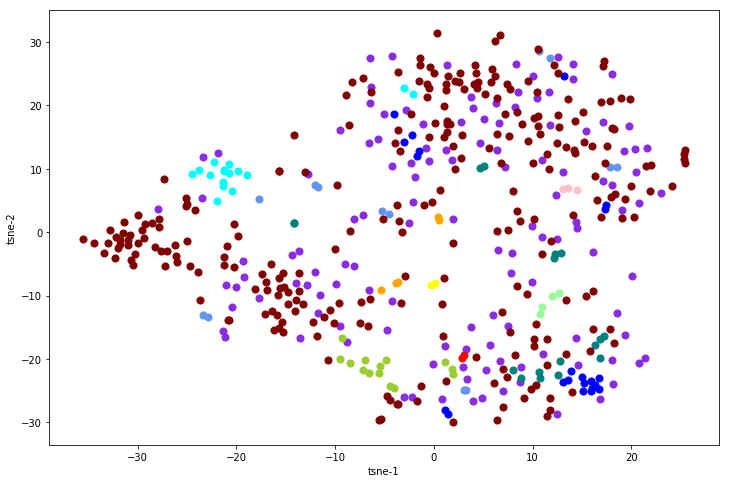

In [60]:
fig = plt.figure(figsize=(12,8))
for i in range(12):
    idx = np.where(labels == i)
    plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color=colors[i])
plt.xlabel('tsne-1')
plt.ylabel('tsne-2')
plt.show()

m4 - dbscan

/home/tkurihana/.conda/envs/tf-cpu/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in sqrt
  """


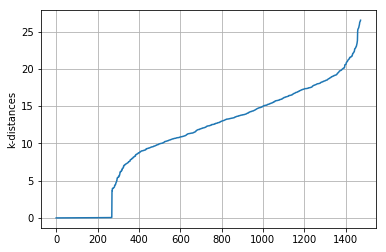

In [161]:
def k_distances2(x, k):
    dim0 = x.shape[0]
    dim1 = x.shape[1]
    p=-2*x.dot(x.T)+np.sum(x**2, axis=1).T+ np.repeat(np.sum(x**2, axis=1),dim0,axis=0).reshape(dim0,dim0)
    p = np.sqrt(p)
    p.sort(axis=1)
    p=p[:,:k]
    pm= p.flatten()
    pm= np.sort(pm)
    return p, pm
encs_list = []
for i in clouds_patches_list:
    encs = encoder.predict(i.reshape(1,128,128,6))
    encs_list += [encs.mean(axis=(1,2))]
features = np.concatenate(encs_list, axis=0)
m, m2= k_distances2(features, 3)
plt.plot(m2)
plt.ylabel("k-distances")
plt.grid(True)
plt.show()

In [206]:
dbscan_clouds_patches_labels, dbscan_feats = compute_dbscan(
    encoder, clouds_patches_list, eps=9.0)
dbscan_clouds_patches_labels.max()

3

In [207]:
dbscan_cimg_array = reconst_img(patches, dbscan_clouds_patches_labels, clouds_xy_list)

In [210]:
cimg_clearsky_array = copy.deepcopy(dbscan_cimg_array)
cimg_clearsky_array[clear_sky_idx] = 4#n_clusters 

<bound method Figure.tight_layout of <Figure size 504x504 with 2 Axes>>

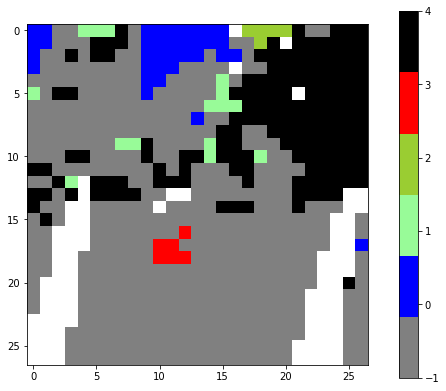

In [212]:
#Plot clusters -- cimg
fig = plt.figure(figsize=(7,7))

colors = ['gray','blue','palegreen', 'yellowgreen', 'red', 'black']
cmap_name = 'my_list2'
cmap2 = LinearSegmentedColormap.from_list(cmap_name, colors, N=6)
plt.imshow(cimg_clearsky_array, cmap=cmap2)
#plt.title("# cloud with model " )
#plt.colorbar(orientation='vertical')
plt.colorbar(orientation='vertical',fraction=0.047, pad=0.08)
fig.tight_layout
#plt.savefig("CImg_Clustering_With_Model")

In [213]:
patches_ = dbscan_feats
labels = dbscan_clouds_patches_labels
features_2d = compute_tsne(patches_, ndim=2, nperplex=15)

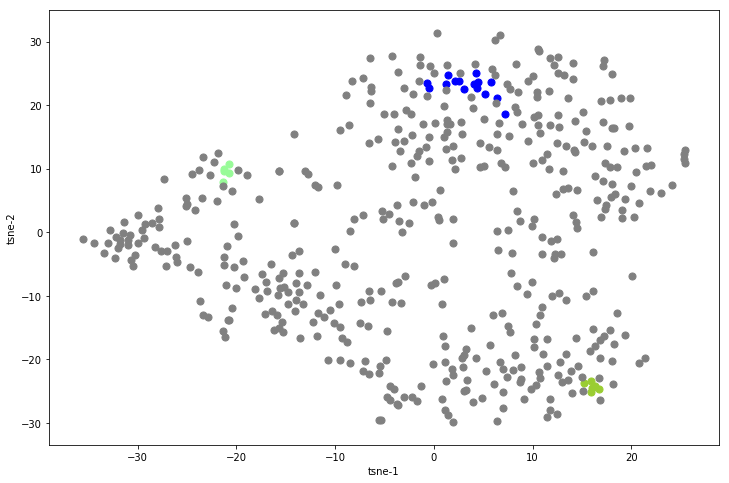

In [215]:
fig = plt.figure(figsize=(12,8))
for i in range(4):
    idx = np.where(labels == i)
    plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color=colors[i])
idx = np.where(labels == -1)
plt.scatter(features_2d[idx,0], features_2d[idx,1], s=50, color='gray')
plt.xlabel('tsne-1')
plt.ylabel('tsne-2')
plt.show()

#### Visible image + Cluster

In [216]:
#Access visual data
#vis_file = '/project2/foster/clouds/data/shared/test_img/MOD02/20150628/MOD021KM.A2015179.mosaic.061.2019112165625.mcgscs_000501328368.EV_250_Aggr1km_RefSB_1.hdf'
vis_file = './data/MOD02/MOD021KM.A2015335.mosaic.061.2019272193957.psmcgscs_000501379937.EV_250_Aggr1km_RefSB_1.hdf'
vhdf = SD(vis_file, SDC.READ)
vhdf_sds = vhdf.select("EV_250_Aggr1km_RefSB")
vhdf_array, vis_band = proc_sds(vhdf_sds)

Process bands 1


/home/tkurihana/scratch-midway2/clouds/src_analysis/lib_hdfs/lib_modis02.py:92: RuntimeWarning: invalid value encountered in greater
  invalid_idx = np.where( array > 32767 )


#### m2-normed + cluster

/home/tkurihana/.conda/envs/tf-cpu/lib/python3.6/site-packages/matplotlib/figure.py:98: MatplotlibDeprecationWarning: 
Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  "Adding an axes using the same arguments as a previous axes "


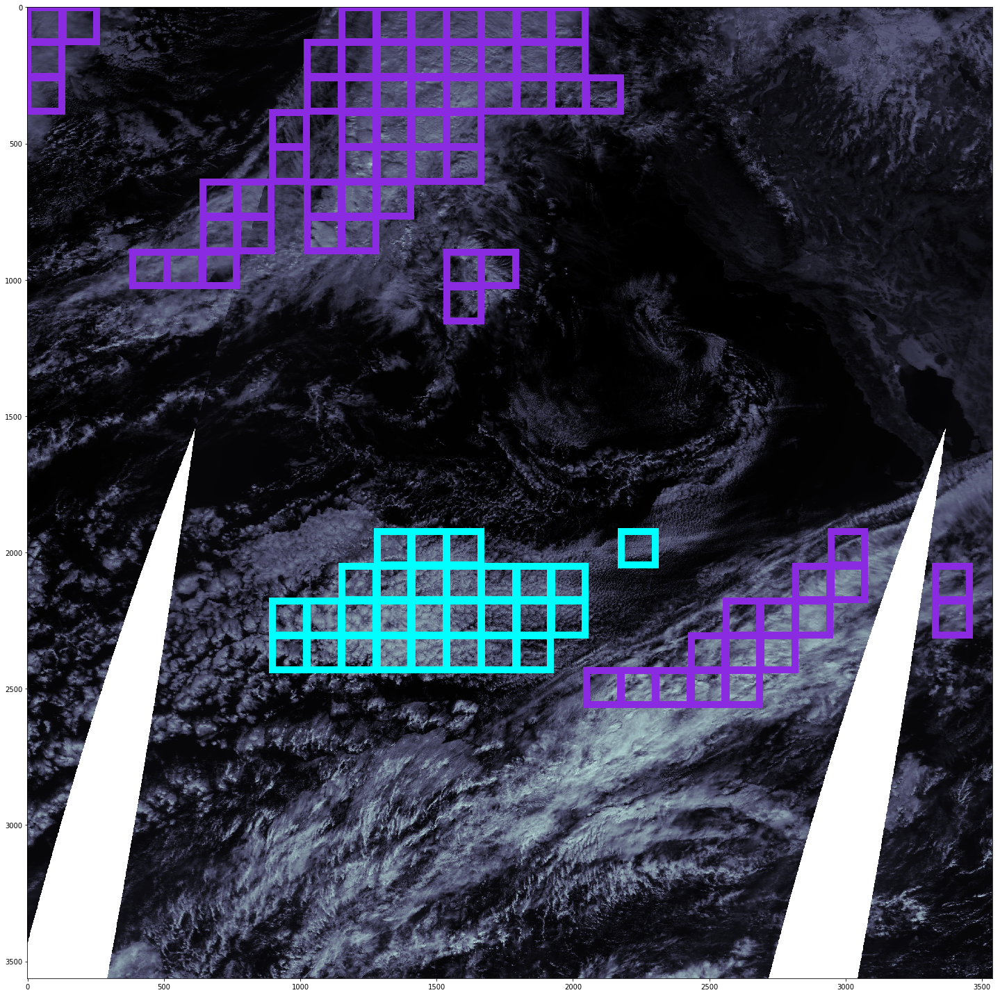

In [222]:
#Plot location of cluster patches on top of visual band image
fig = plt.figure(figsize=(20,20))

line_width = 2
SHAPE = 128,128
#colors = cmap
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'Grey']
for idx, icluster in enumerate(range(n_clusters)):
    ax = plt.subplot(1,1,1)
    plt.imshow(vhdf_array, cmap='bone')
    #ax.set_title("cluster == %d"%(icluster), fontsize=43)
    for i in range(normed_patches.shape[0]):
        for j in range(normed_patches.shape[1]):
            #==============================================
            if not np.isnan(normed_agl_cimg_array[i,j]):
                if normed_agl_cimg_array[i,j] == 0 or normed_agl_cimg_array[i,j] == 4:
                    
                    #======================================
                    ax.add_patch(mpl_patches.Rectangle(
                      (j * SHAPE[0] + line_width , i * SHAPE[1] + line_width ),
                      width=SHAPE[0] - line_width * 2,
                      height=SHAPE[1] - line_width * 2,
                      linewidth=10,
                      edgecolor=colors[int(normed_agl_cimg_array[i,j])],
                      facecolor="none"                 
                      ))
fig.tight_layout()
plt.show()
#plt.savefig("Visual_clusters_
plt.close()

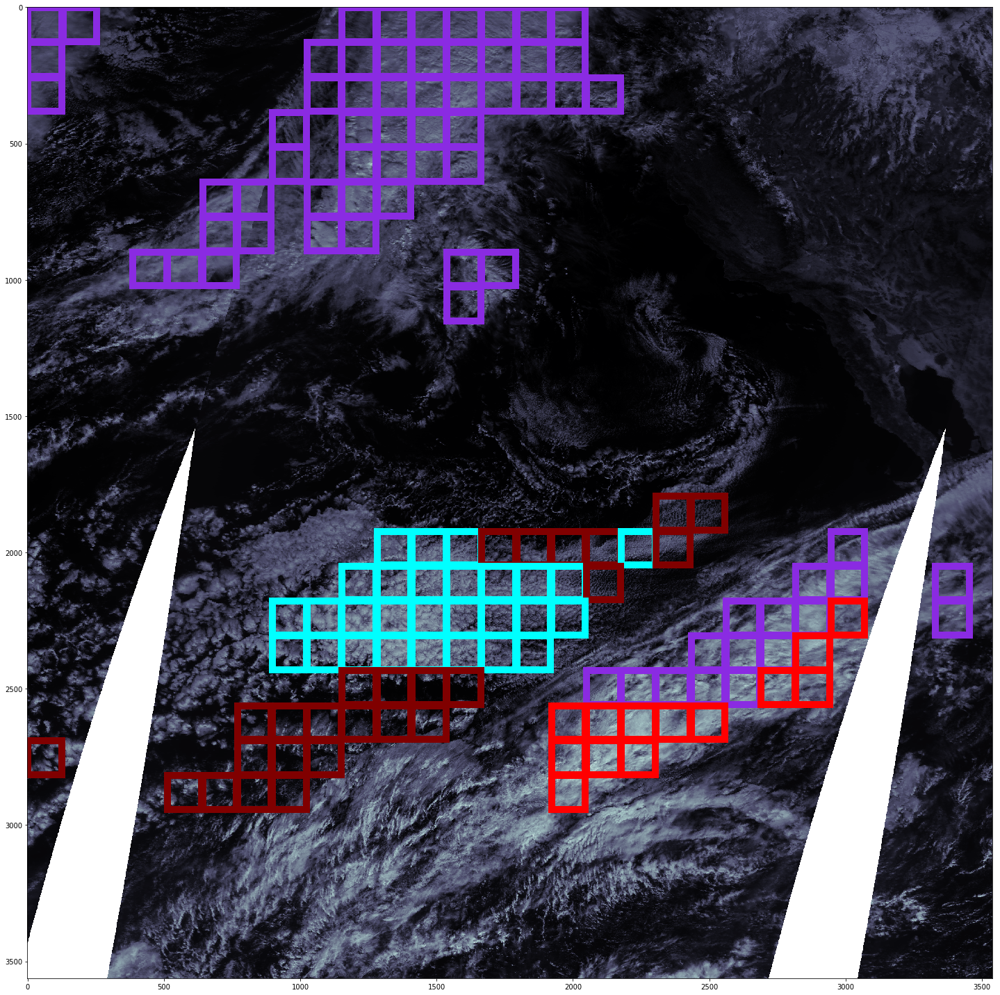

In [226]:
#Plot location of cluster patches on top of visual band image
fig = plt.figure(figsize=(20,20))

line_width = 2
SHAPE = 128,128
#colors = cmap
colors = ['blueviolet','cornflowerblue','blue','teal',
         'aqua','palegreen', 'yellowgreen', 'pink',
         'yellow','orange','red','maroon', 'Grey']
for idx, icluster in enumerate(range(n_clusters)):
    ax = plt.subplot(1,1,1)
    plt.imshow(vhdf_array, cmap='bone')
    #ax.set_title("cluster == %d"%(icluster), fontsize=43)
    for i in range(normed_patches.shape[0]):
        for j in range(normed_patches.shape[1]):
            #==============================================
            if not np.isnan(normed_agl_cimg_array[i,j]):
                #if normed_agl_cimg_array[i,j] == 0 or normed_agl_cimg_array[i,j] == 4:
                if normed_agl_cimg_array[i,j] in [0,4,10,11]:
                    #======================================
                    ax.add_patch(mpl_patches.Rectangle(
                      (j * SHAPE[0] + line_width , i * SHAPE[1] + line_width ),
                      width=SHAPE[0] - line_width * 2,
                      height=SHAPE[1] - line_width * 2,
                      linewidth=10,
                      edgecolor=colors[int(normed_agl_cimg_array[i,j])],
                      facecolor="none"                 
                      ))
fig.tight_layout()
plt.show()
#plt.savefig("Visual_clusters_
plt.close()